In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
#import torch
import anndata as ad
import scanpy as sc
import polars as pl

In [22]:
def run_scanpy(adata):
    print("Starting scanpy!")
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pp.neighbors(adata, n_neighbors=500, n_pcs=50)
    sc.tl.paga(adata, groups="Metadata_cmpdName")
    sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
    sc.tl.umap(adata, init_pos='random')
    print("Embedding complete. Saving file!")

In [12]:
adata_DINO = ad.read_h5ad("/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/datasets_paper/celldeath_DINO_sampled.h5ad")
adata_DP = ad.read_h5ad("/home/jovyan/share/data/analyses/benjamin/cellxgene/Beactica/celldeath/deepprofiler/umap.h5ad")
adata_CP = ad.read_h5ad("/home/jovyan/share/data/analyses/benjamin/cellxgene/Beactica/celldeath/cellprofiler/CP_sc_embedding_sampled.h5ad")

In [8]:
adata_DINO = adata_DINO[adata_DINO.obs["outliers"] == "unassigned"] #drop outliers

In [50]:
adata_filter_grit = ad.AnnData(X = filtered_sc_profiles_DINO[ [col for col in filtered_sc_profiles_DINO.columns if "Feature" in col]].to_pandas(), obs = filtered_sc_profiles_DINO[ [col for col in filtered_sc_profiles_DINO.columns if "Feature" not in col]].to_pandas())

/usr/local/lib/python3.10/dist-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [11]:
adata_apoptosis = adata_filter_grit[adata_filter_grit.obs["moa"] == "apoptosis"]

## Run unsupervised analysis

In [23]:
run_scanpy(adata_DINO)
run_scanpy(adata_DP)
run_scanpy(adata_CP)

Starting scanpy!


Embedding complete. Saving file!


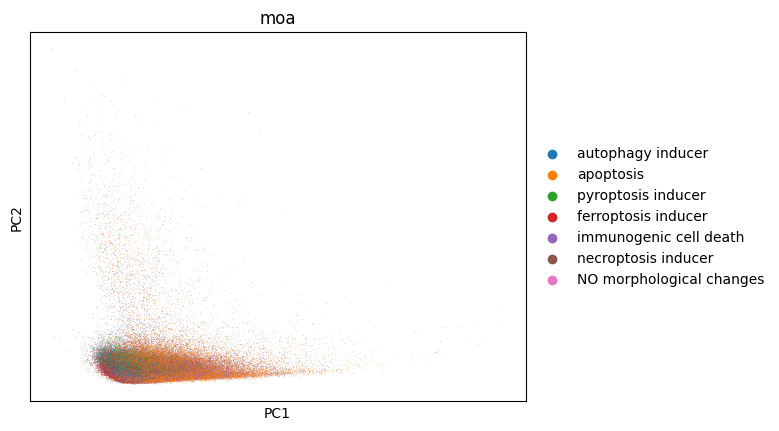

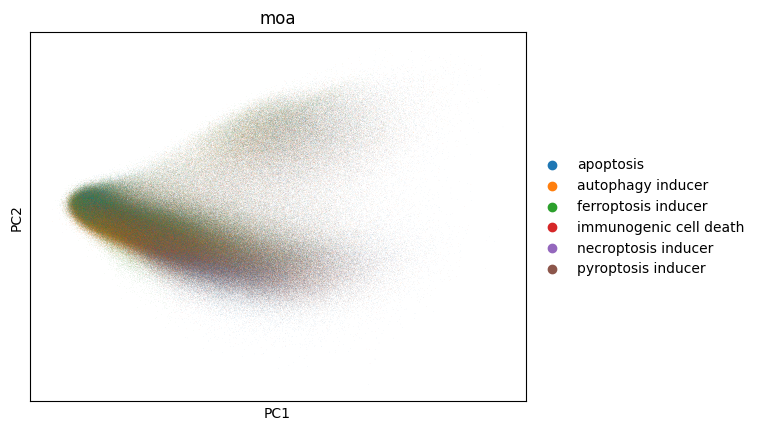

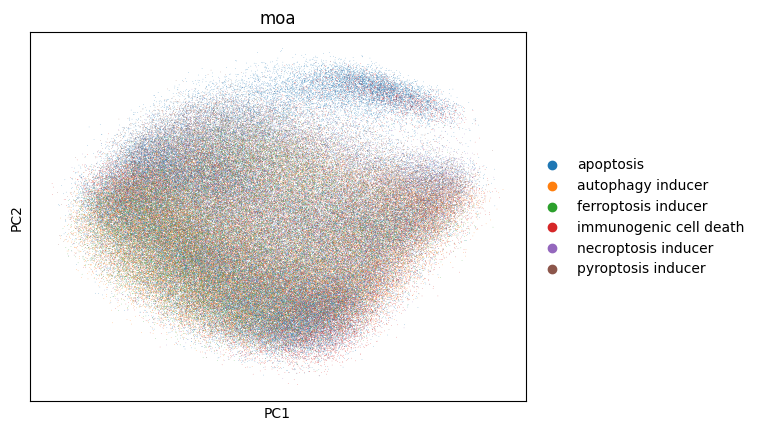

In [7]:
sc.pl.pca(adata_CP, color = ['moa'])
sc.pl.pca(adata_DP, color = ['moa'])
sc.pl.pca(adata_DINO, color = ['moa'])

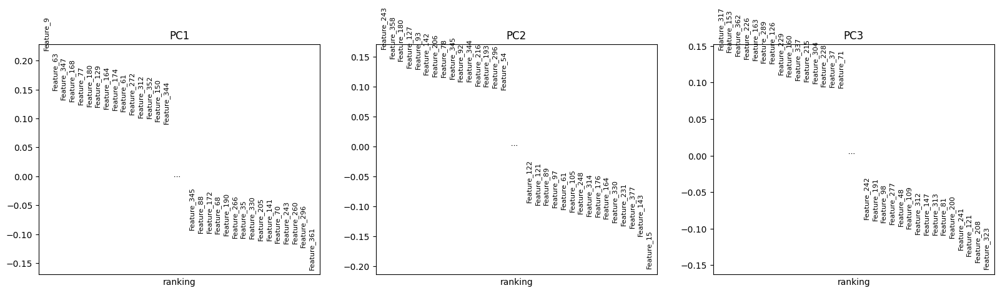

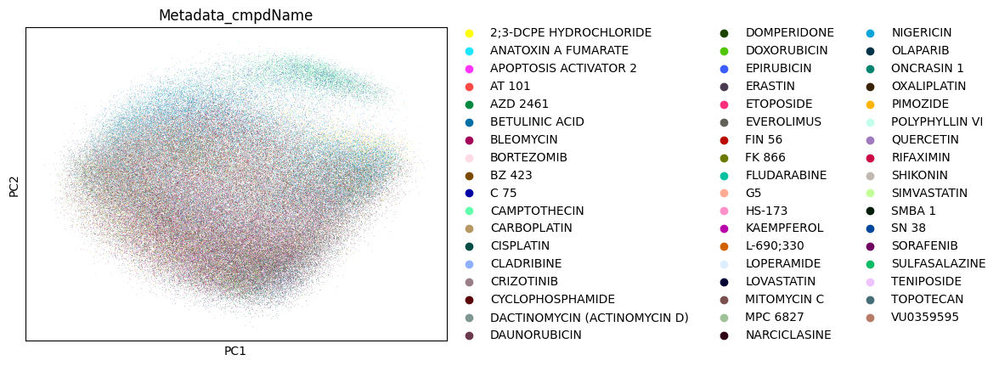

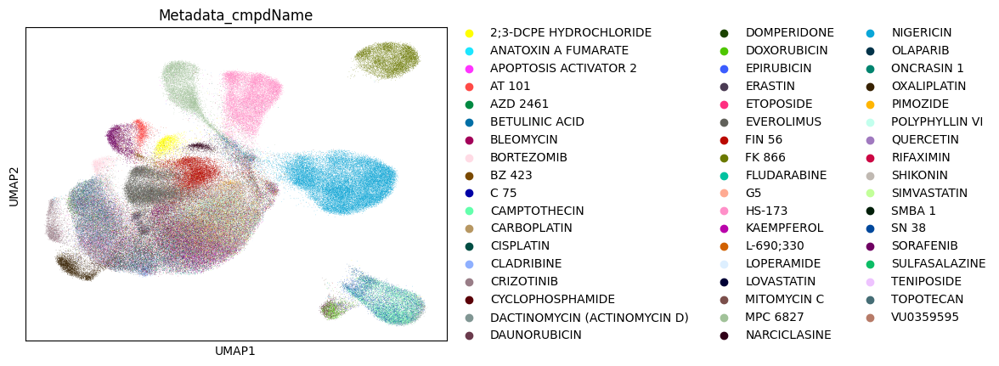

In [24]:
sc.pl.umap(adata_DINO, color = ['moa'], title ="DINO")
sc.pl.umap(adata_DP, color = ['moa'], title ="DP")
sc.pl.umap(adata_CP,color = ['moa'], title ="CP")

In [23]:
import matplotlib.pyplot as plt
import scanpy as sc
from scanpy.plotting import palettes
from matplotlib.lines import Line2D

def plot_combined_umap(
    adata1, adata2, adata3, color_column="Metadata_cmpdName", 
    title1="DINO", title2="DeepProfiler", title3="CellProfiler", 
    save_path=None
):
    """
    Plots UMAPs of three AnnData objects with a shared color map and a single legend.
    
    Parameters:
    - adata1, adata2, adata3: AnnData objects to plot.
    - color_column (str): Column in `.obs` to use for coloring.
    - title1, title2, title3 (str): Titles for each subplot.
    - save_path (str, optional): File path to save the figure. If None, it won’t save the figure.
    
    Returns:
    - None: Displays the combined plot with a single legend.
    """
    # Use the standard Scanpy color palette
    default_palette = palettes.default_102[:60]  # Support up to 60 colors from Scanpy
    assert len(default_palette) >= 60, "Scanpy palette does not support more than 60 colors."

    # Get all unique categories across the three AnnData objects
    unique_categories = (
        set(adata1.obs[color_column].unique())
        .union(adata2.obs[color_column].unique())
        .union(adata3.obs[color_column].unique())
    )
    
    # Map the colors to the unique categories and sort by category name
    palette = default_palette[:len(unique_categories)]  # Adjust palette size to unique categories
    category_colors = dict(zip(sorted(unique_categories), palette))  # Sort categories alphabetically

    # Handle missing categories in each AnnData object
    def assign_colors(adata, color_column, category_colors):
        adata_categories = adata.obs[color_column].astype("category").cat.categories
        adata.uns[f"{color_column}_colors"] = [
            category_colors[cat] if cat in category_colors else "#d3d3d3"  # Assign default gray for missing categories
            for cat in adata_categories
        ]

    assign_colors(adata1, color_column, category_colors)
    assign_colors(adata2, color_column, category_colors)
    assign_colors(adata3, color_column, category_colors)

    # Create a figure with 3 subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Plot UMAP for each dataset
    sc.pl.umap(adata1, color=[color_column], title=title1, ax=axes[0], legend_loc="none", show=False)
    sc.pl.umap(adata2, color=[color_column], title=title2, ax=axes[1], legend_loc="none", show=False)
    sc.pl.umap(adata3, color=[color_column], title=title3, ax=axes[2], legend_loc="none", show=False)

    # Create a single legend using alphabetically sorted categories and colors
    legend_elements = [
        Line2D([0], [0], marker="o", color="w", markerfacecolor=category_colors[cat], markersize=10, label=cat)
        for cat in sorted(unique_categories)
    ]
    fig.legend(handles=legend_elements, title=color_column, loc="center right", bbox_to_anchor=(1.05, 0.5))

    # Adjust layout and optionally save the figure
    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space on the right for the legend
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.show()


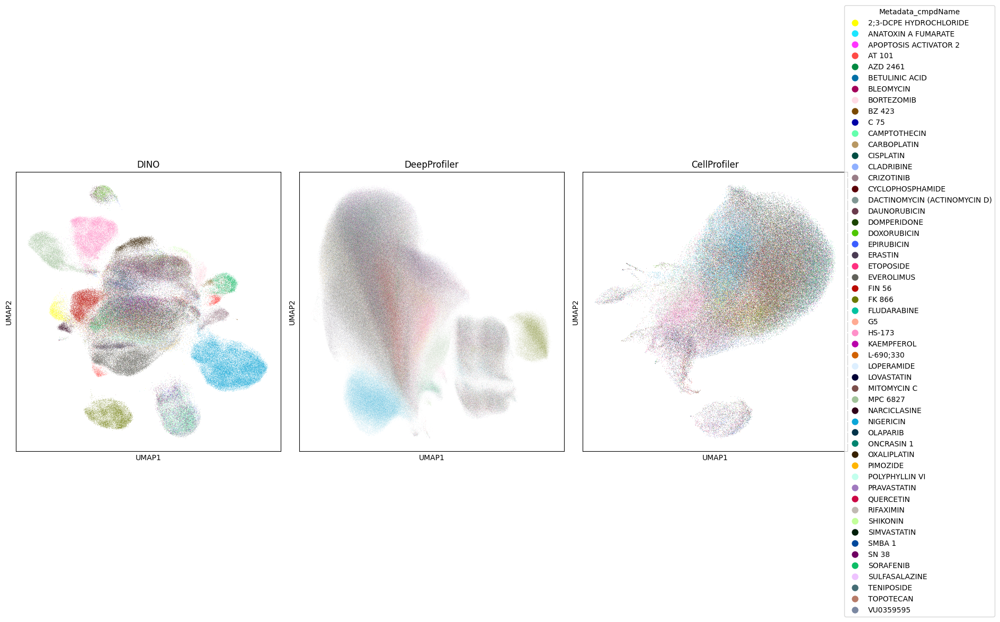

In [24]:
plot_combined_umap(adata_DINO, adata_DP, adata_CP, color_column="Metadata_cmpdName", save_path="big_combined_umap.png")

In [50]:
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import seaborn as sns
from matplotlib.lines import Line2D    
def make_jointplot_anndata(adata, dmso_name, colouring, cmpd, save_path=None):
    # Extract UMAP data from .obsm
    umap_data = pd.DataFrame(adata.obsm['X_umap'], columns=['UMAP1', 'UMAP2']).reset_index()

    # Join with metadata from .obs
    embedding = pd.concat([umap_data,pd.DataFrame(adata.obs).reset_index()], axis = 1)
    #embedding = embedding.reset_index()
    embedding[colouring] = embedding[colouring].str.strip('[]')
    #embedding["Metadata_cmpdNameConc2"] = embedding["Metadata_cmpdName"].astype(str) + "_" + embedding["Metadata_cmpdConc"].astype(str)
    # Generate a color palette based on unique values in the colouring column
    unique_treatments = embedding[colouring].unique()
    palette = sns.color_palette("tab10", len(unique_treatments))
    color_map = dict(zip(unique_treatments, palette))
    #print(color_map)
    # Adjust colors and transparency if colouring is 'Metadata_cmpdName'
    if colouring == 'Metadata_cmpdName':
        if dmso_name in color_map:
            color_map[dmso_name] = "lightgrey"
    color_map = {'autophagy inducer': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765), 'apoptosis': (1.0, 0.4980392156862745, 0.054901960784313725), 'ferroptosis inducer': (0.17254901960784313, 0.6274509803921569, 0.17254901960784313), 'immunogenic cell death': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392), 'pyroptosis inducer': (0.5803921568627451, 0.403921568627451, 0.7411764705882353), 'necroptosis inducer': (0.5490196078431373, 0.33725490196078434, 0.29411764705882354)}
    embedding['color'] = embedding[colouring].map(color_map)
    point_size = 5
    embedding['size'] = point_size
    
    # Increase the DPI for displaying
    plt.rcParams['figure.dpi'] = 300
    
    # Create the base joint plot
    g = sns.JointGrid(x='UMAP1', y='UMAP2', data=embedding, height=10)

    # Plot KDE plots for each category
    for treatment in sorted(unique_treatments):  # Sort alphabetically
        subset = embedding[embedding[colouring] == treatment]
        
        sns.kdeplot(x=subset["UMAP1"], ax=g.ax_marg_x, fill=True, color=color_map[treatment], legend=False)
        sns.kdeplot(y=subset["UMAP2"], ax=g.ax_marg_y, fill=True, color=color_map[treatment], legend=False)

    # Plot the scatter plots
    for treatment in sorted(unique_treatments):  # Sort alphabetically
        subset = embedding[embedding[colouring] == treatment]
        alpha_val = 0.3 if treatment == dmso_name and colouring == 'Metadata_cmpdName' else 0.5
        g.ax_joint.scatter(subset["UMAP1"], subset["UMAP2"], c=subset['color'], s=subset['size'], label=treatment, alpha=alpha_val, linewidth=0.0)
    
    g.ax_joint.set_title(cmpd)
    g.ax_joint.grid(False)
    g.ax_marg_x.grid(False)
    g.ax_marg_y.grid(False)
    #legend = g.ax_joint.legend(fontsize=10)
    #legend.get_frame().set_facecolor('white')
    legend_elements = [Line2D([0], [0], marker='o', linestyle="None", color=color_map[treatment], label=f"{treatment}", markersize=5, markerfacecolor=color_map[treatment], alpha=1) for treatment in sorted(unique_treatments)]  # Sort alphabetically
    legend = g.ax_joint.legend(handles=legend_elements, fontsize=10, title="moa")
    legend.get_frame().set_facecolor('white')
    
    if save_path != None:
        current_time = datetime.datetime.now()
        timestamp = current_time.strftime("%Y%m%d_%H%M%S")
        g.savefig(f"{save_path}.png", dpi=300)

    plt.show()

In [29]:
make_jointplot_anndata(adata_DINO, 'DMSO', "moa", "")

NameError: name 'make_jointplot_anndata' is not defined

In [ ]:
make_jointplot_anndata(adata_DP, 'DMSO', "moa", "")

In [ ]:
make_jointplot_anndata(adata_CP, 'DMSO', "moa", "")

## Density analysis 

In [ ]:
sc.tl.embedding_density(adata_DINO, basis='umap', groupby='moa')
sc.pl.embedding_density(adata_DINO, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_moa')

sc.tl.embedding_density(adata_CP, basis='umap', groupby='moa')
sc.pl.embedding_density(adata_CP, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_moa')

sc.tl.embedding_density(adata_DP, basis='umap', groupby='moa')
sc.pl.embedding_density(adata_DP, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_moa')

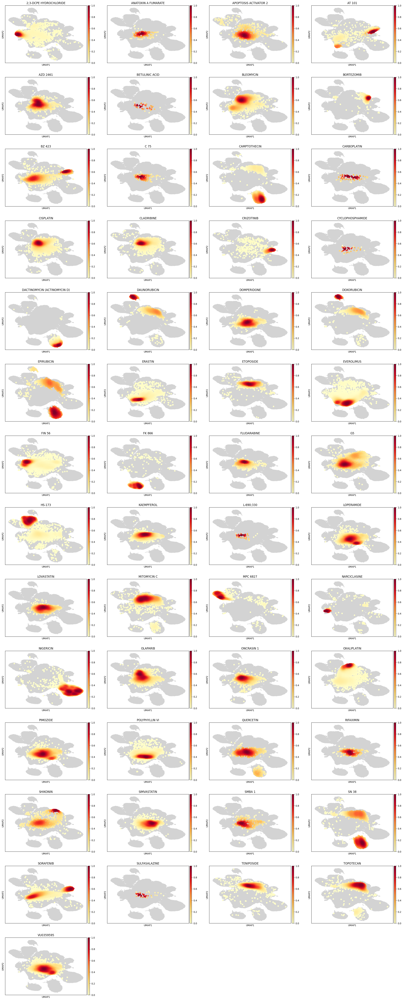

In [4]:
sc.tl.embedding_density(adata_filter_grit, basis='umap', groupby='Metadata_cmpdName')
sc.pl.embedding_density(adata_filter_grit, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_Metadata_cmpdName')

## Per moa  

### CellProfiler

In [ ]:
moas = list(adata_CP.obs["moa"].unique())
adata_moa_cp = {}
for moa in moas:
    print(moa)
    filter_adata = adata_CP[adata_CP.obs["moa"] == moa]
    run_scanpy(filter_adata)
    sc.pl.umap(filter_adata, color = "Metadata_cmpdName")
    sc.tl.embedding_density(filter_adata, basis='umap', groupby='Metadata_cmpdName')
    sc.pl.embedding_density(filter_adata, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_Metadata_cmpdName')
    adata_moa_cp[moa] = filter_adata

### DeepProfiler

In [ ]:
moas = list(adata_DP.obs["moa"].unique())
adata_moa_dp = {}
for moa in moas:
    print(moa)
    filter_adata = adata_DP[adata_DP.obs["moa"] == moa]
    run_scanpy(filter_adata)
    sc.pl.umap(filter_adata, color = "Metadata_cmpdName")
    sc.tl.embedding_density(filter_adata, basis='umap', groupby='Metadata_cmpdName')
    sc.pl.embedding_density(filter_adata, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_Metadata_cmpdName')
    adata_moa_dp[moa] = filter_adata

### DINO

apoptosis
Starting scanpy!


/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_pca.py:317: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm[key_obsm] = X_pca


Embedding complete. Saving file!


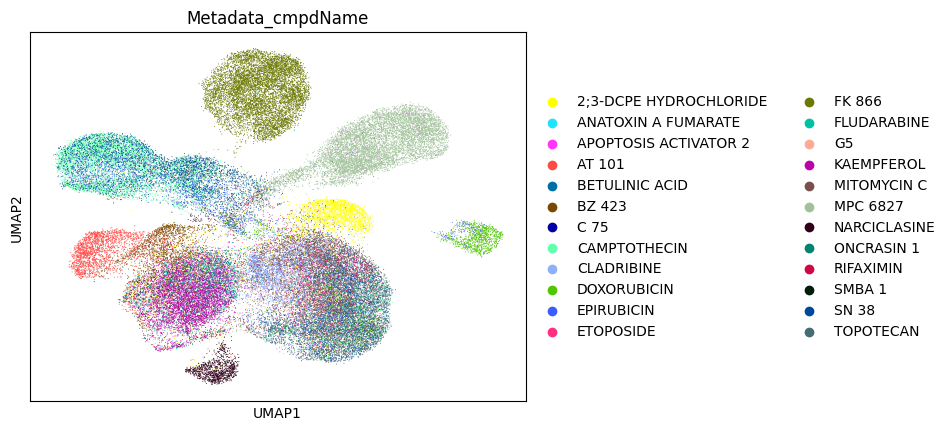

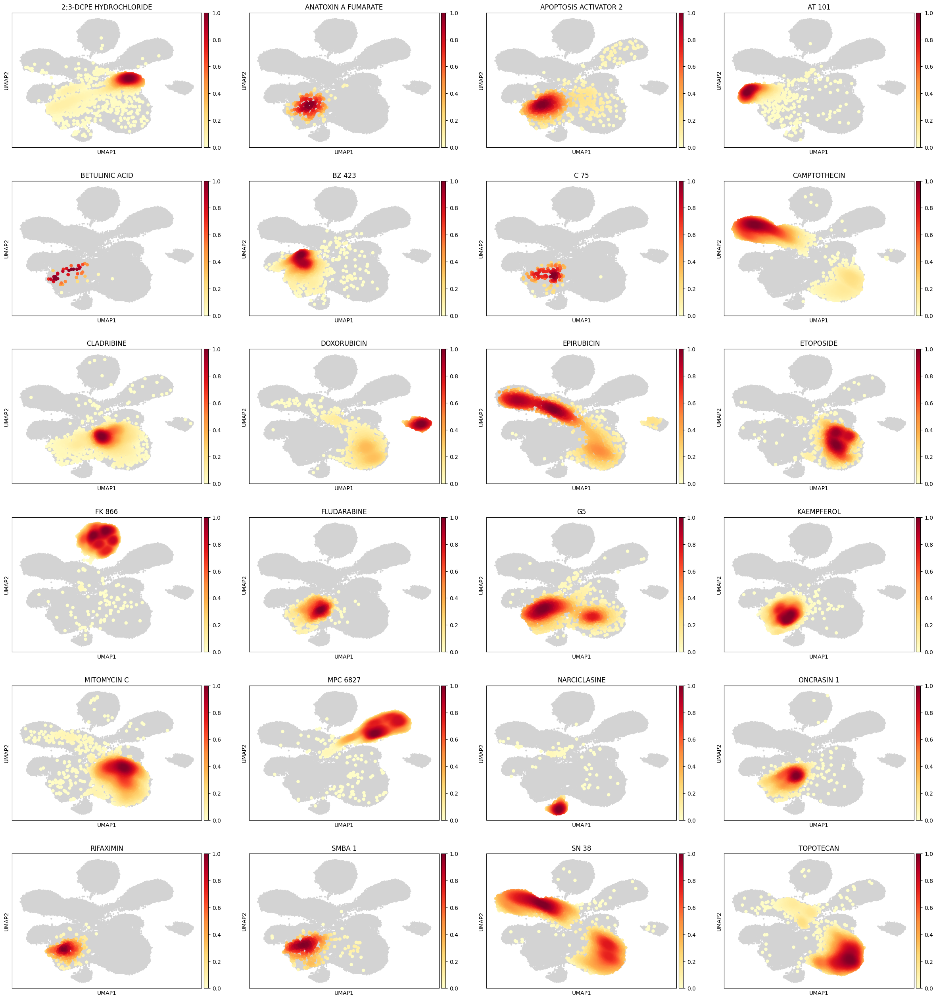

TypeError: unhashable type: 'Categorical'

In [72]:
moa = adata_filter_grit.obs["moa"].unique()
adata_moa_DINO = {}
for m in moa:
    if m != "apoptosis":
        continue
    print(m)
    adata_filt = adata_filter_grit[adata_filter_grit.obs["moa"]== m]
    run_scanpy(adata_filt)
    sc.pl.umap(adata_filt, color = "Metadata_cmpdName")
    sc.tl.embedding_density(adata_filt, basis='umap', groupby='Metadata_cmpdName')
    sc.pl.embedding_density(adata_filt, bg_dotsize = 40, fg_dotsize= 150, basis='umap', key='umap_density_Metadata_cmpdName')
    adata_moa_DINO[moa] = adata_filt

## Apoptosis analysis

In [ ]:
adata_apoptosis_DINO = ad.read_h5ad("celldeath_DINO_apoptosis.h5ad")
apoptosis_adata_DP = ad.read_h5ad("/home/jovyan/share/data/analyses/benjamin/cellxgene/Beactica/celldeath/deepprofiler/apoptosis_embedding_DP.h5ad")
apoptosis_adata_CP = ad.read_h5ad("/home/jovyan/share/data/analyses/benjamin/cellxgene/Beactica/celldeath/cellprofiler/apoptosis_embedding_CP.h5ad")

In [ ]:
import matplotlib.pyplot as plt
import scanpy as sc
import seaborn as sns
from scanpy.plotting import palettes
from matplotlib.colors import ListedColormap
from matplotlib.lines import Line2D

def plot_combined_umap_apoptosis(adata1, adata2, adata3, color_column="Metadata_cmpdName", title1="DINO", title2="DeepProfiler", title3="CellProfiler", save_path=None):
    """
    Plots UMAPs of three AnnData objects with a shared color map and a single legend.
    
    Parameters:
    - adata1, adata2, adata3: AnnData objects to plot.
    - color_column (str): Column in `.obs` to use for coloring.
    - title1, title2, title3 (str): Titles for each subplot.
    - save_path (str, optional): File path to save the figure. If None, it won’t save the figure.
    
    Returns:
    - None: Displays the combined plot with a single legend.
    """
    # Define the default_26 color palette used by scanpy
    default_26 = [
        "#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b", "#e377c2", 
        "#7f7f7f", "#bcbd22", "#17becf", "#aec7e8", "#ffbb78", "#98df8a", "#ff9896", 
        "#c5b0d5", "#c49c94", "#f7b6d2", "#c7c7c7", "#dbdb8d", "#9edae5", "#393b79", 
        "#637939", "#8c6d31", "#843c39", "#7b4173", "#5254a3"
    ]
    
    # Get all unique categories across the three AnnData objects
    unique_categories = (
        set(adata1.obs[color_column].unique())
        .union(adata2.obs[color_column].unique())
        .union(adata3.obs[color_column].unique())
    )

    # Map the colors to the unique categories and sort by category name
    palette = default_26[:len(unique_categories)]  # Adjust if there are more than 26 categories
    category_colors = dict(zip(sorted(unique_categories), palette))  # Sort by category name

    # Assign the color map to each AnnData object
    adata1.uns[f"{color_column}_colors"] = [category_colors[cat] for cat in sorted(adata1.obs[color_column].cat.categories)]
    adata2.uns[f"{color_column}_colors"] = [category_colors[cat] for cat in sorted(adata2.obs[color_column].cat.categories)]
    adata3.uns[f"{color_column}_colors"] = [category_colors[cat] for cat in sorted(adata3.obs[color_column].cat.categories)]

    # Create a figure with 3 subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Plot UMAP for each dataset
    sc.pl.umap(adata1, color=[color_column], title=title1, ax=axes[0], legend_loc= "none", show=False)
    sc.pl.umap(adata2, color=[color_column], title=title2, ax=axes[1], legend_loc = "none", show=False)
    sc.pl.umap(adata3, color=[color_column], title=title3, ax=axes[2], legend_loc = "none", show=False)

    # Create a single legend using alphabetically sorted categories and colors
    legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor=category_colors[cat], markersize=10, label=cat) for cat in sorted(unique_categories)]
    fig.legend(handles=legend_elements, title=color_column, loc="center right", bbox_to_anchor=(1.05, 0.5))

    # Adjust layout and optionally save the figure
    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space on the right for the legend
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.show()


In [ ]:
plot_combined_umap_apoptosis(adata_apoptosis_agg, apoptosis_adata_DP_agg, apoptosis_adata_CP_agg, color_column="Metadata_cmpdName", save_path="apoptosis_combined_umap.png")


## Aggregated analysis

Same for non-apoptosis aggregates

In [14]:
def calculate_group_medians(adata, group_columns):
    # Ensure the columns exist in obs
    for col in group_columns:
        if col not in adata.obs:
            raise ValueError(f"Column {col} not found in obs.")
    
    # Group by the specified columns
    group_keys = adata.obs[group_columns].astype(str).agg("_".join, axis=1)
    adata.obs['group_key'] = group_keys
    
    # Calculate the median per group
    grouped = adata.to_df().groupby(adata.obs['group_key']).median()
    
    # Retrieve the unique combinations of group columns for obs
    unique_obs = adata.obs.drop_duplicates(subset='group_key')[['group_key'] + group_columns].set_index('group_key')
    unique_obs = unique_obs.loc[grouped.index]
    
    return grouped, unique_obs

group_columns = ['Metadata_Plate', 'Metadata_Site', "Metadata_Well", "moa", "Metadata_cmpdName", "Metadata_cmpdConc"]  # Replace with your column names

In [ ]:
median_data, new_obs = calculate_group_medians(adata_apoptosis_DINO, group_columns)

apoptosis_adata_DINO_agg = sc.AnnData(X=median_data.values, obs=new_obs)
apoptosis_adata_DINO_agg.var_names = adata_apoptosis_DINO.var_names

In [22]:
median_data, new_obs = calculate_group_medians(apoptosis_adata_DP, group_columns)

apoptosis_adata_DP_agg = sc.AnnData(X=median_data.values, obs=new_obs)
apoptosis_adata_DP.var_names = apoptosis_adata_DP.var_names

In [23]:
median_data, new_obs = calculate_group_medians(apoptosis_adata_CP, group_columns)

apoptosis_adata_CP_agg = sc.AnnData(X=median_data.values, obs=new_obs)
apoptosis_adata_CP_agg.var_names = apoptosis_adata_CP.var_names

In [24]:
run_scanpy(apoptosis_adata_DP_agg)
run_scanpy(apoptosis_adata_CP_agg)
run_scanpy(apoptosis_adata_DINO_agg)

Starting scanpy!
Embedding complete. Saving file!
Starting scanpy!
Embedding complete. Saving file!


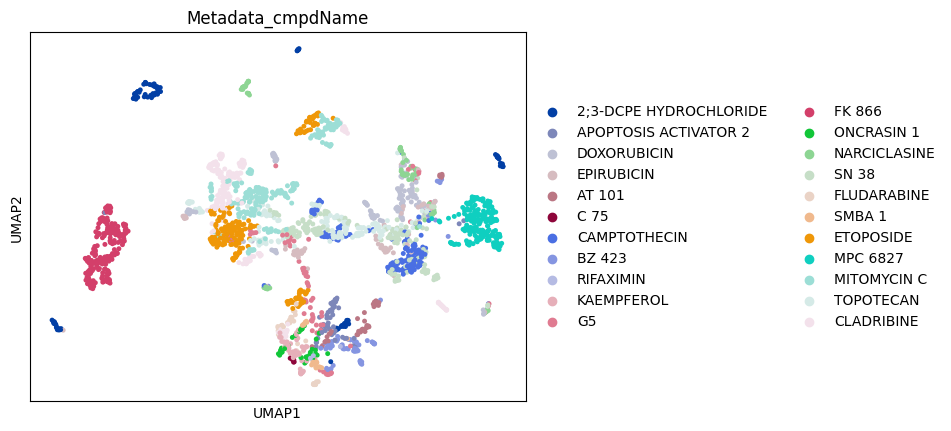

In [26]:
sc.pl.umap(apoptosis_adata_CP_agg, color = "Metadata_cmpdName")
sc.pl.umap(apoptosis_adata_DP_agg, color = "Metadata_cmpdName")
sc.pl.umap(apoptosis_adata_DINO_agg, color = "Metadata_cmpdName")

# Dose response analysis

In [46]:
comp_list_paper = ["CLADRIBINE", "SN 38", "FK 866", "MPC 6827", "TOPOTECAN", "DOXORUBICIN", "EPIRUBICIN"]

In [85]:
import scanpy as sc
import numpy as np

def run_density_estimation(data, query_compound, umap_key='X_umap', max_cells=5000, target_cells=5000, min_cells=100):
    """
    Runs density estimation on an AnnData object, highlighting the density of a specific compound concentration.
    
    Parameters:
    data (AnnData): AnnData object containing the UMAP and metadata.
    query_compound (str): The compound name to highlight.
    umap_key (str): Key in `.obsm` for the UMAP coordinates (default is 'X_umap').
    max_cells (int): Maximum number of cells allowed in a group before sampling (default is 5000).
    target_cells (int): Target number of cells to sample down to if a group exceeds max_cells (default is 5000).
    min_cells (int): Minimum number of cells required to include a group (default is 100).

    Returns:
    None, directly plots the density estimation map.
    """
    # Step 1: Create a unique identifier for the compound + concentration
    data = data.copy()
    data.obs["Metadata_cmpdNameConc2"] = data.obs["Metadata_cmpdName"].astype(str) + "_" + data.obs["Metadata_cmpdConc"].astype(str)
    data.obs['Metadata_cmpdConc'] = data.obs['Metadata_cmpdConc'].astype("str").astype('category')
    data = data[data.obs["Metadata_cmpdConc"].isin(["0.1", "0.3", "1.0", "5.0"])].copy()
    # Step 2: Create a new column where only the selected compound concentration is kept
    data.obs["Density_Label"] = data.obs.apply(
        lambda row: row["Metadata_cmpdNameConc2"] if row["Metadata_cmpdName"] == query_compound else "Apoptosis embedding", axis=1
    )
    data.obs['Density_Label'] = data.obs['Density_Label'].astype('category')

    # Step 3: Sample based on the `Density_Label` column
    sampled_indices = []
    for label in data.obs["Density_Label"].unique():
        label_cells = data.obs["Density_Label"] == label
        num_cells = label_cells.sum()
        if num_cells < min_cells:
            print(f"Skipping group '{label}' as it has only {num_cells} cells, which is below the minimum threshold of {min_cells}.")
            continue

        if num_cells > max_cells:  # Only sample for the compound of interest
            # Sample down to target number of cells for the query compound
            sampled_indices.extend(np.random.choice(data[label_cells].obs_names, size=target_cells, replace=False))
        else:
            # Keep all cells if below the threshold or it's the "Other compound" group
            sampled_indices.extend(data[label_cells].obs_names)

    # Create a new AnnData object with the sampled cells
    data = data[sampled_indices].copy()

    # Step 4: Run scanpy's density estimation on the new grouping
    sc.tl.embedding_density(data, basis='umap', groupby='Density_Label')
    sc.pl.embedding_density(
        data, 
        bg_dotsize=40, 
        fg_dotsize=150, 
        basis='umap', 
        key='umap_density_Density_Label', 
        groups=[label for label in data.obs["Density_Label"].cat.categories if label != "Apoptosis embedding"],
        ncols=7
    )

### CellProfiler

CLADRIBINE


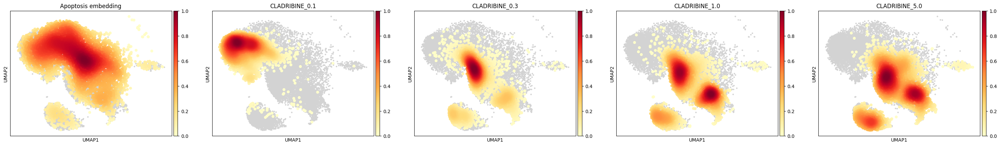

BZ 423


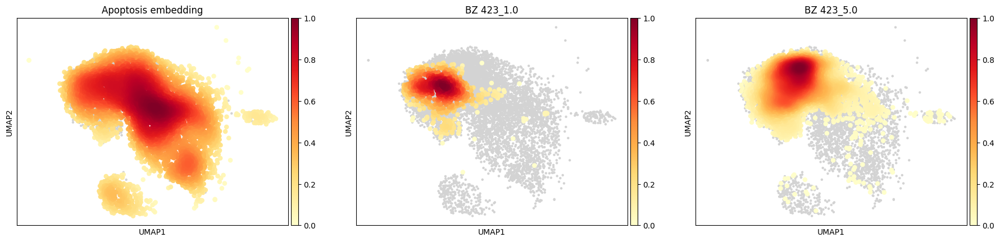

SN 38


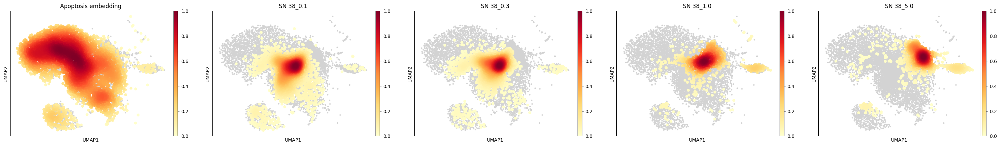

ONCRASIN 1


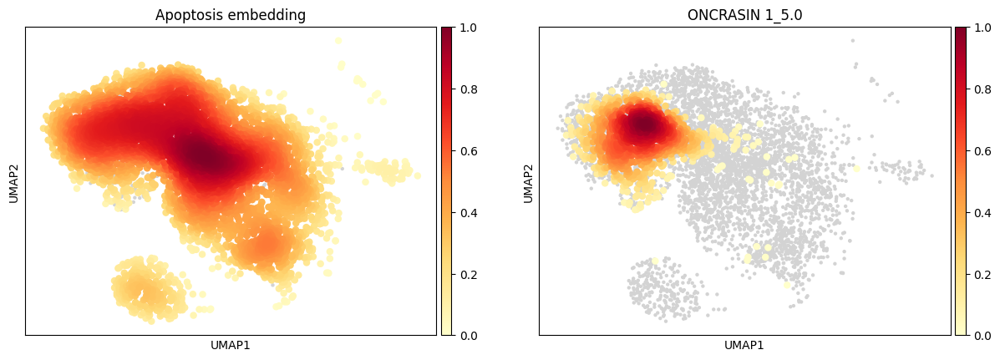

APOPTOSIS ACTIVATOR 2


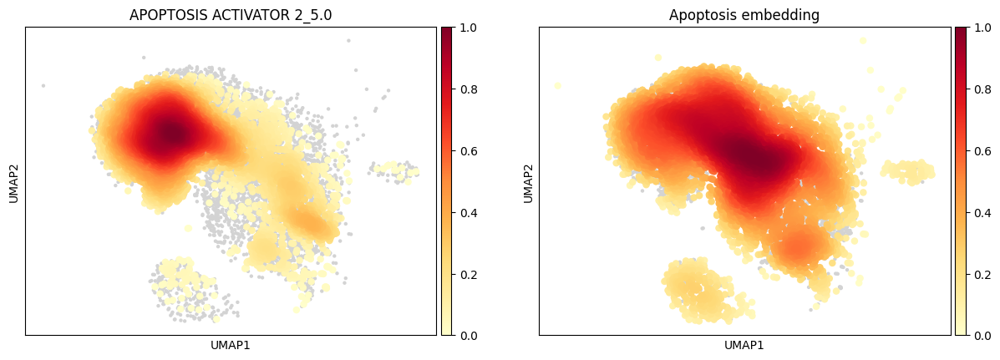

FK 866


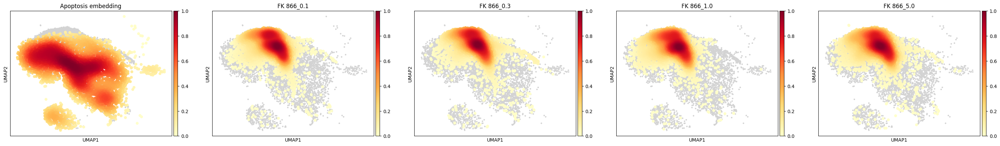

FLUDARABINE


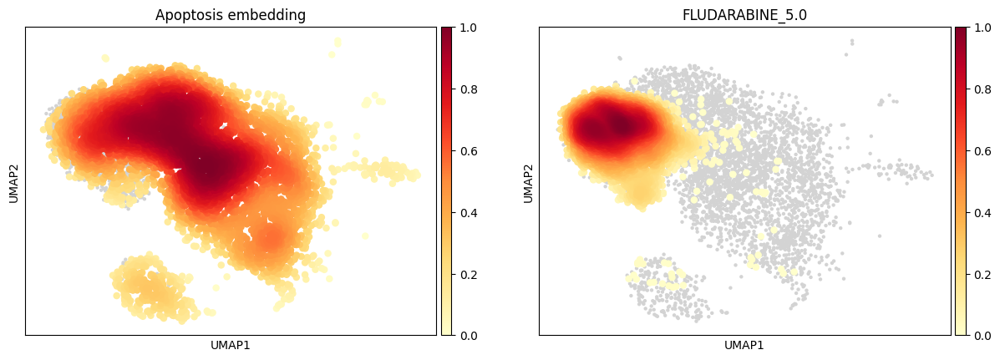

KAEMPFEROL


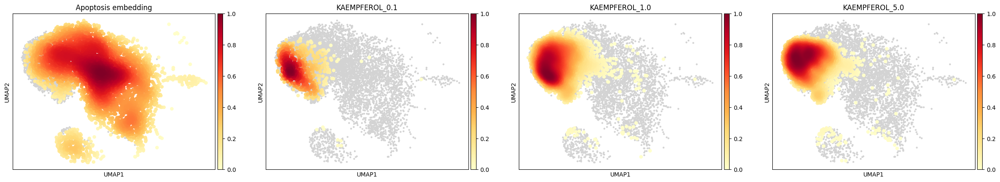

ETOPOSIDE


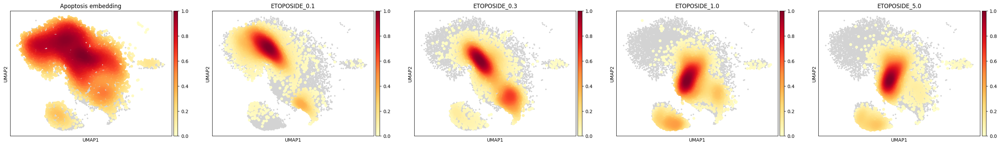

MPC 6827


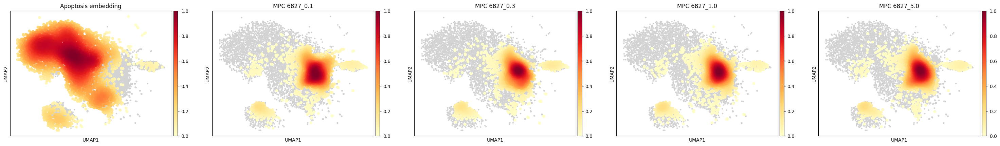

TOPOTECAN


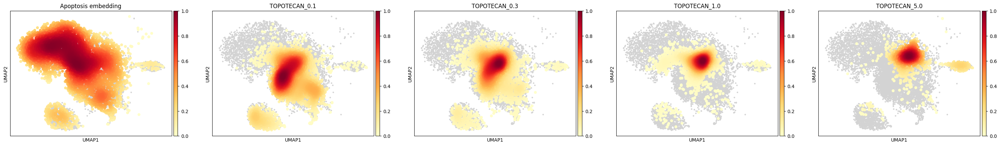

RIFAXIMIN


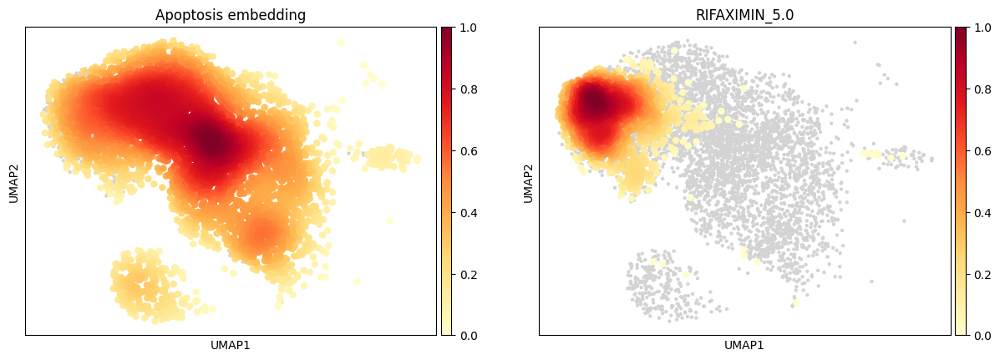

MITOMYCIN C


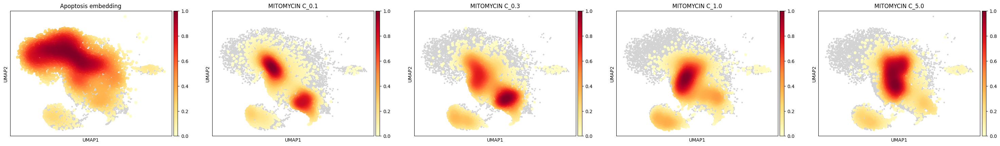

BETULINIC ACID


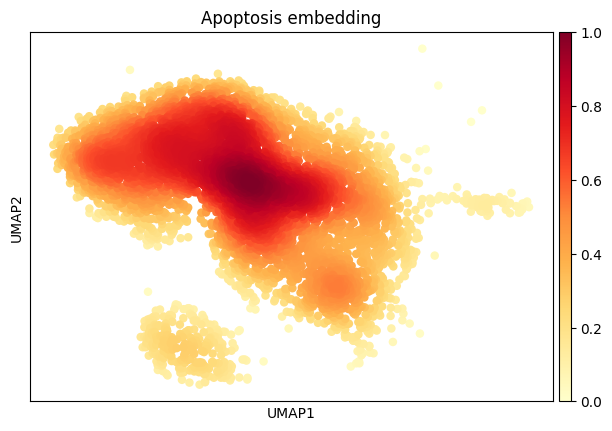

DOXORUBICIN


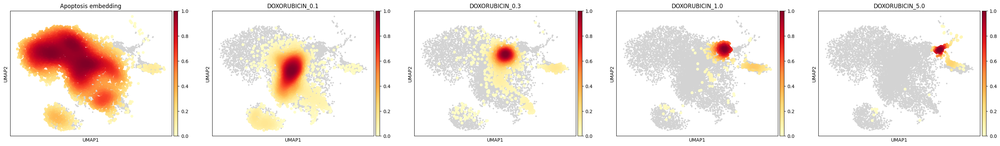

CAMPTOTHECIN


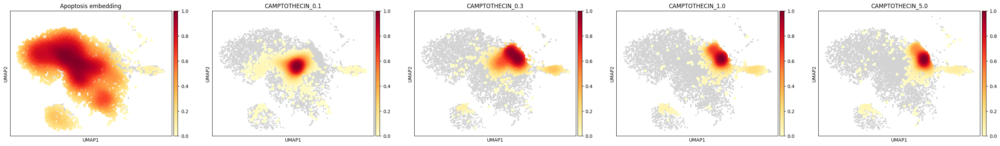

G5
Skipping group 'G5_1.0' as it has only 85 cells, which is below the minimum threshold of 100.
Skipping group 'G5_5.0' as it has only 30 cells, which is below the minimum threshold of 100.


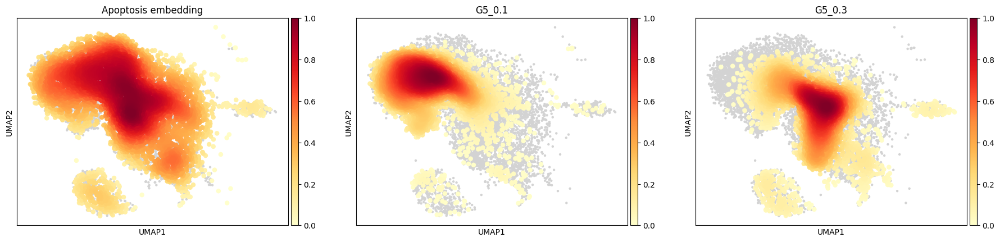

2;3-DCPE HYDROCHLORIDE
Skipping group '2;3-DCPE HYDROCHLORIDE_1.0' as it has only 63 cells, which is below the minimum threshold of 100.


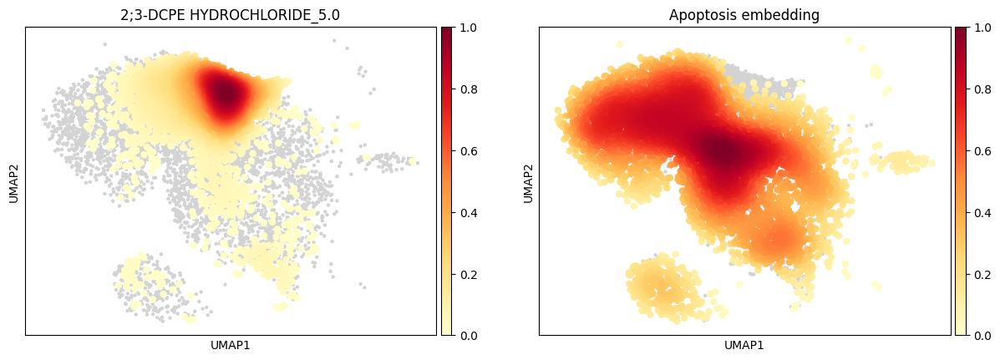

C 75


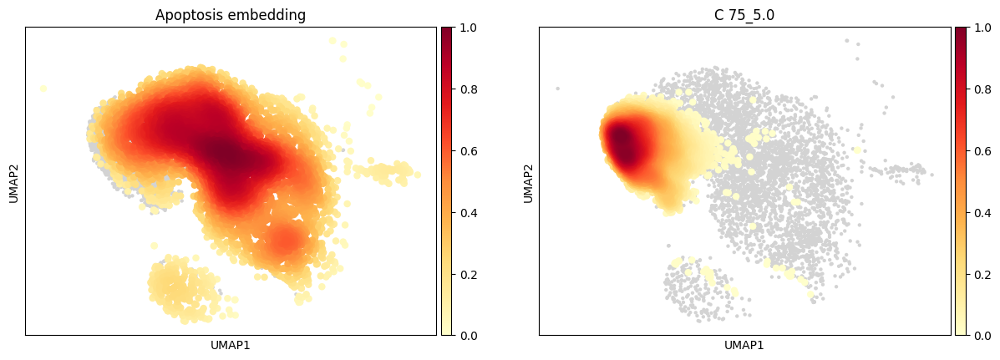

SMBA 1


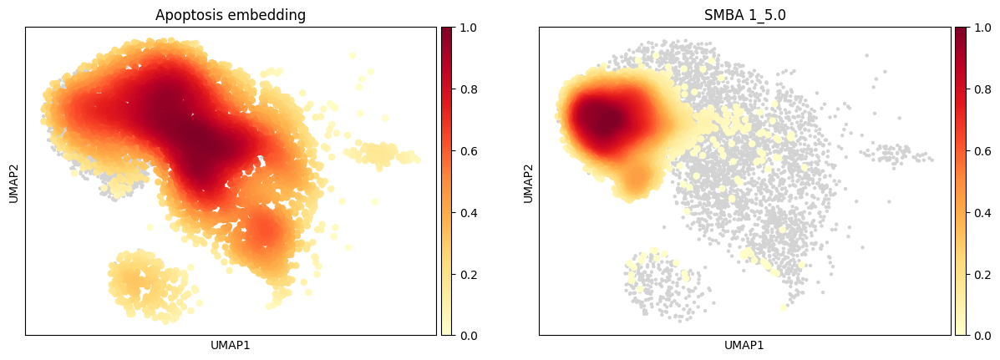

EPIRUBICIN


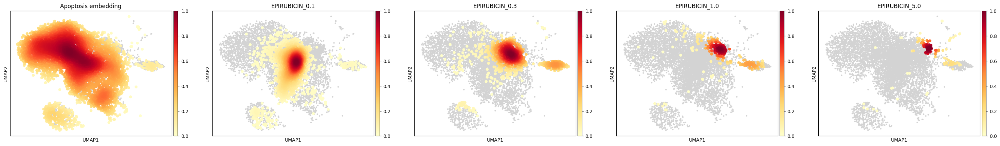

NARCICLASINE


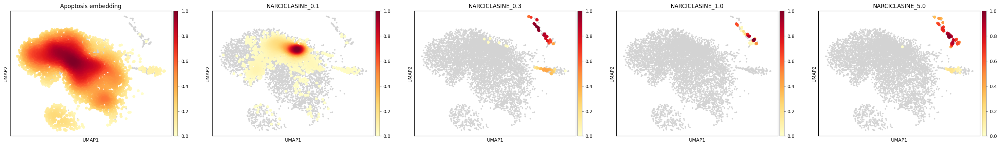

AT 101


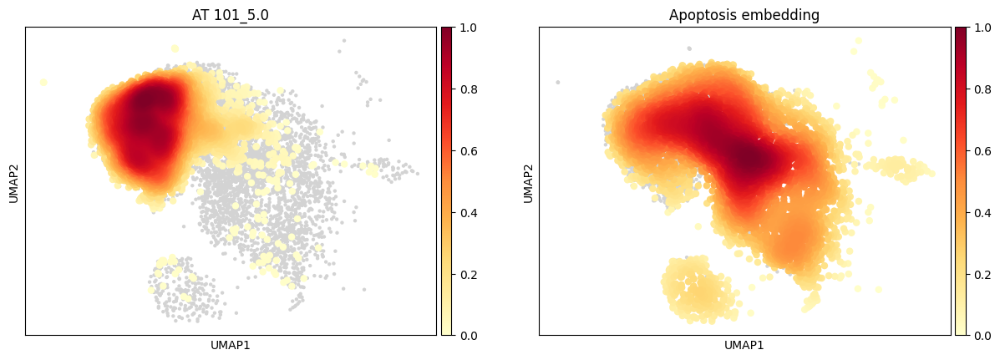

ANATOXIN A FUMARATE


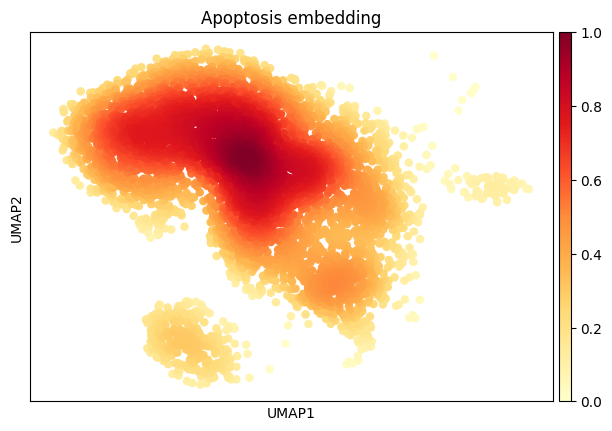

In [92]:
for comp in comp_list_paper:
    print(comp)
    run_density_estimation(apoptosis_adata_CP, comp)

### DeepProfiler

CLADRIBINE


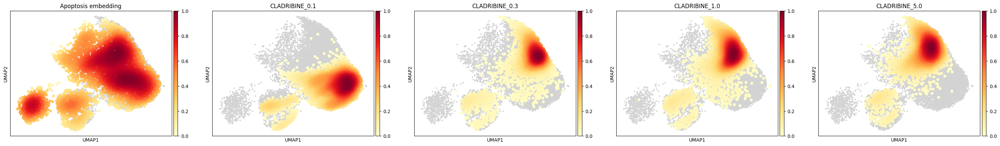

BZ 423


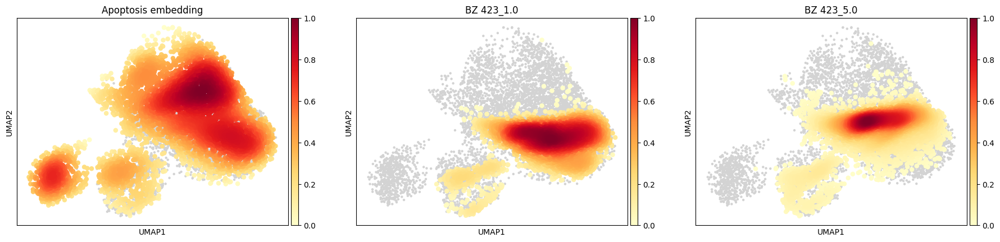

SN 38


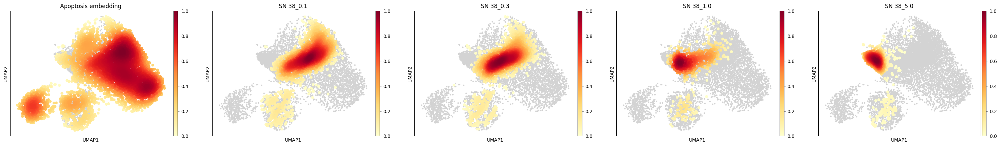

ONCRASIN 1


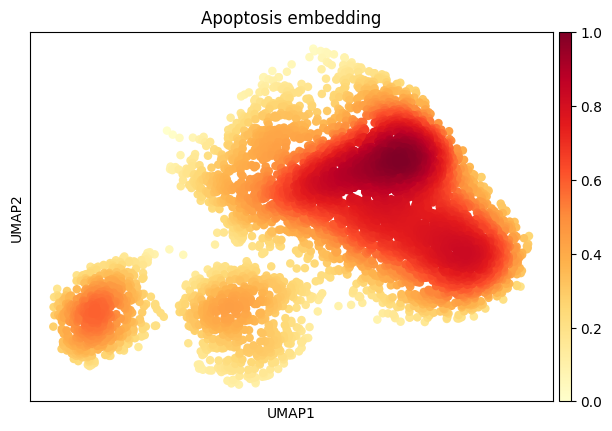

APOPTOSIS ACTIVATOR 2


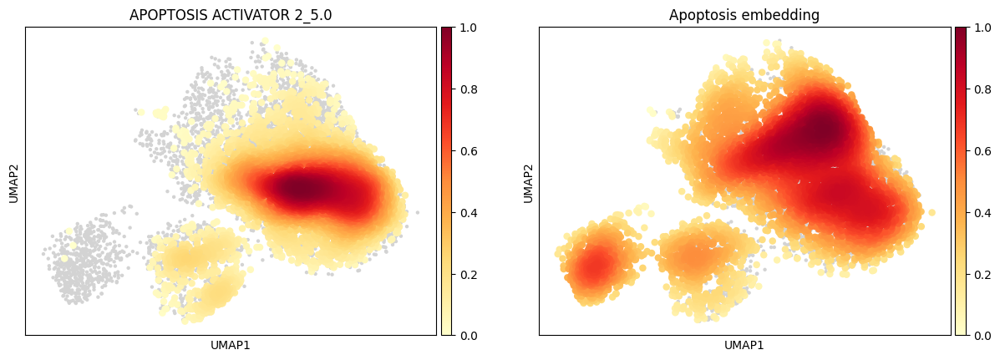

FK 866


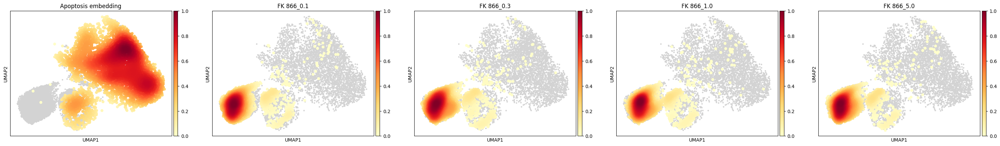

FLUDARABINE


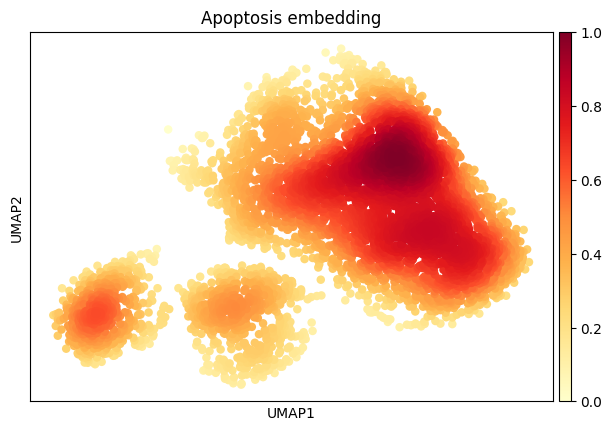

KAEMPFEROL


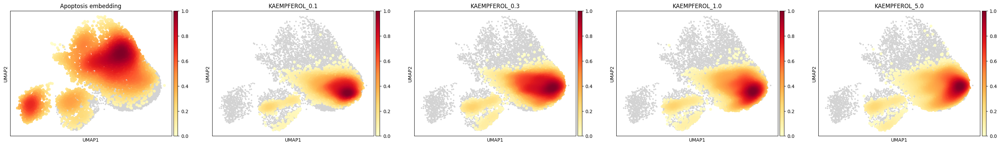

ETOPOSIDE


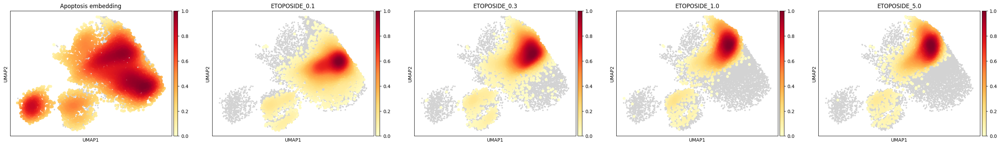

MPC 6827


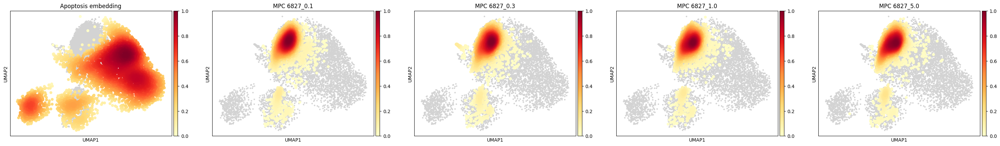

TOPOTECAN


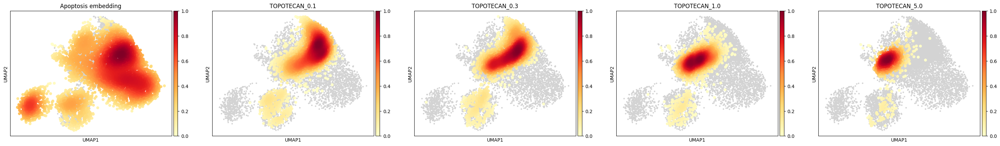

RIFAXIMIN


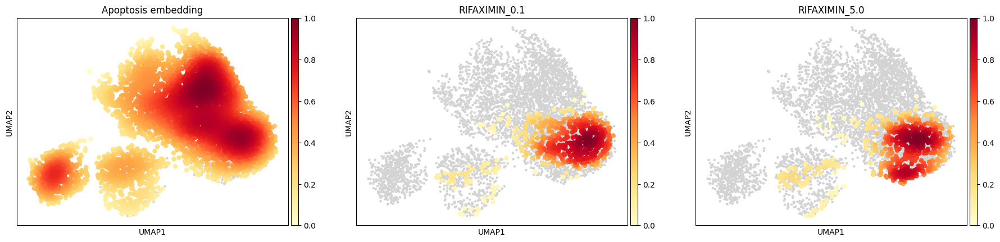

MITOMYCIN C


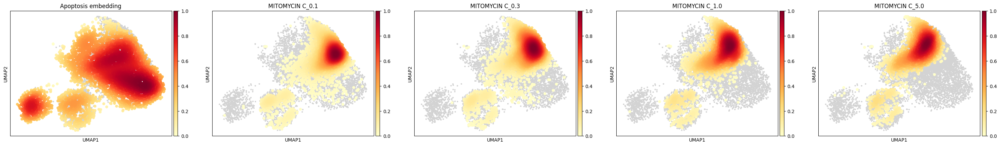

BETULINIC ACID


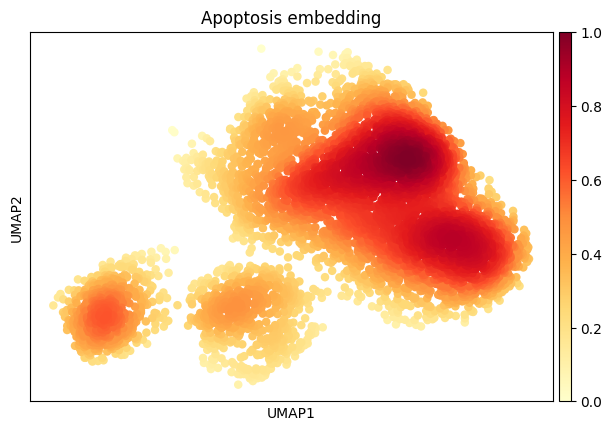

DOXORUBICIN


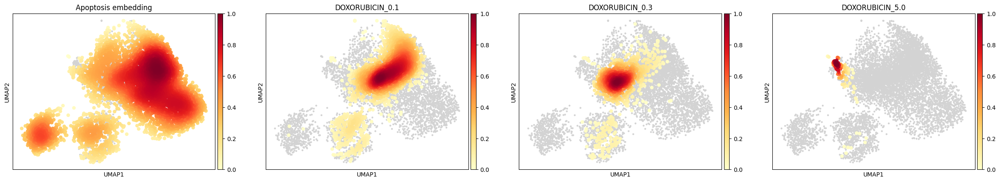

CAMPTOTHECIN


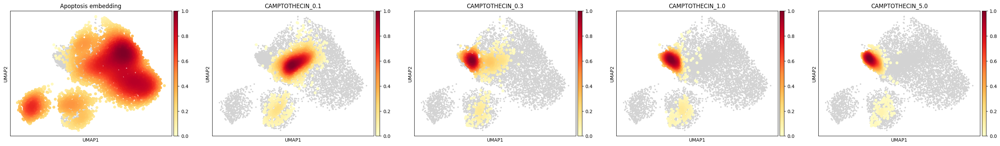

G5


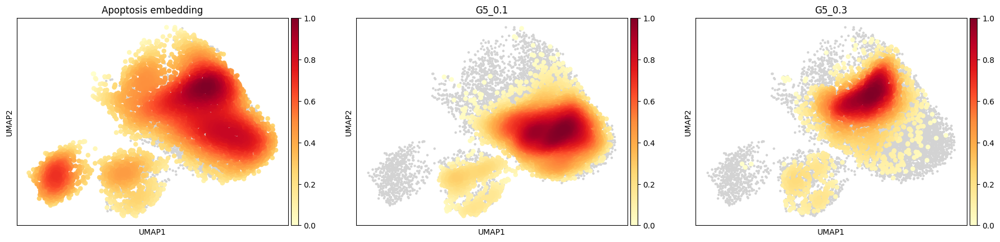

2;3-DCPE HYDROCHLORIDE


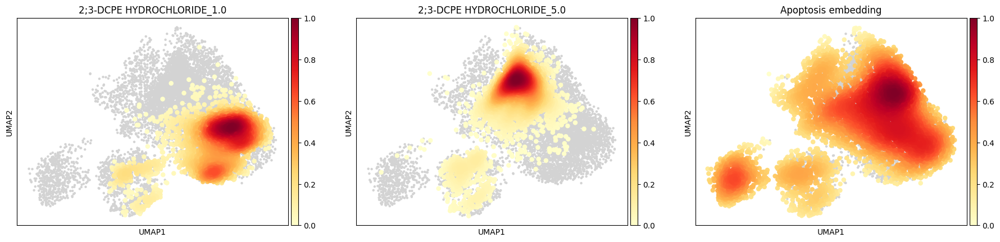

C 75


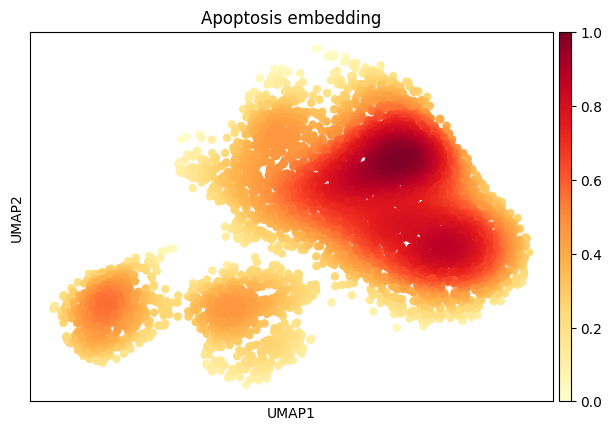

SMBA 1


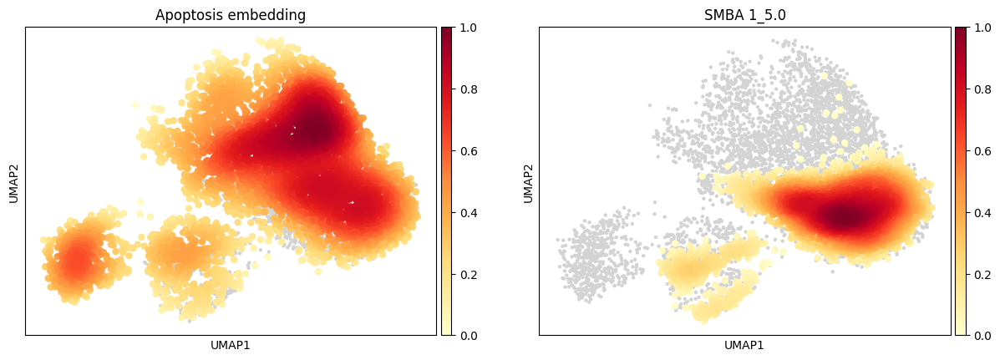

EPIRUBICIN
Skipping group 'EPIRUBICIN_5.0' as it has only 92 cells, which is below the minimum threshold of 100.


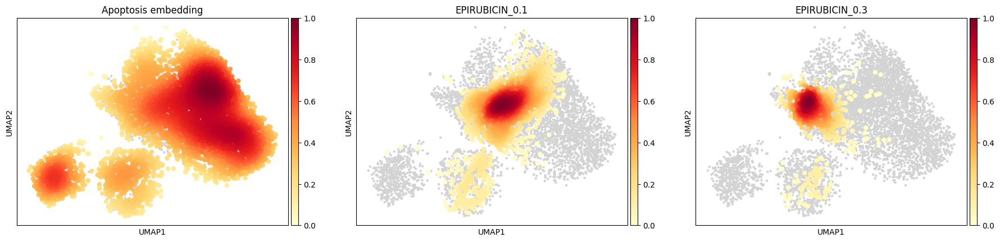

NARCICLASINE
Skipping group 'NARCICLASINE_0.3' as it has only 91 cells, which is below the minimum threshold of 100.


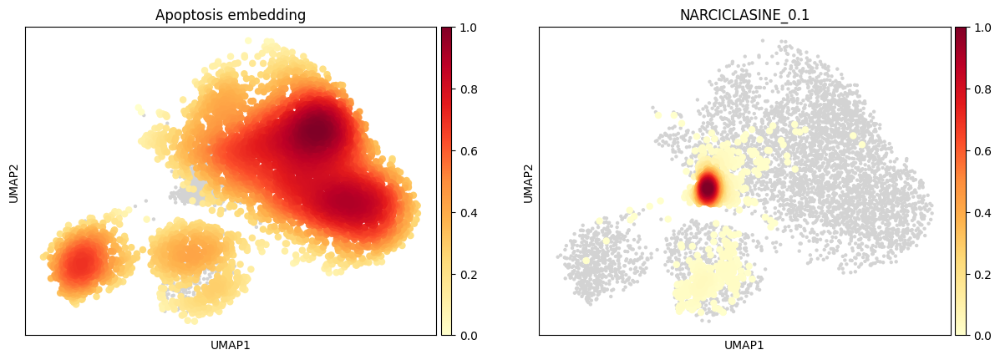

AT 101


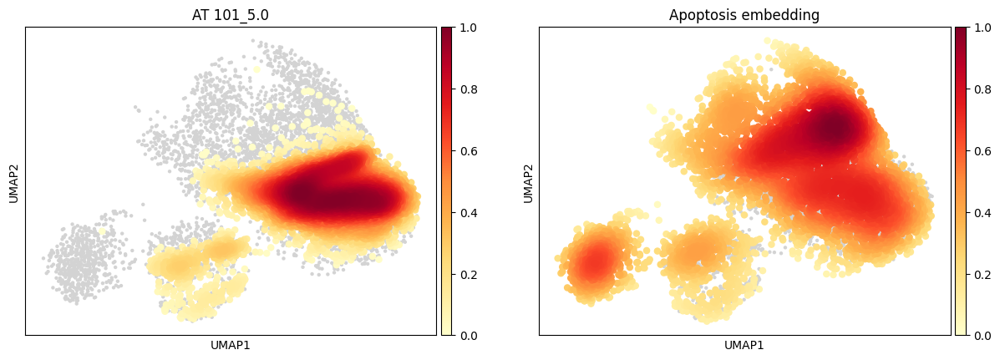

ANATOXIN A FUMARATE


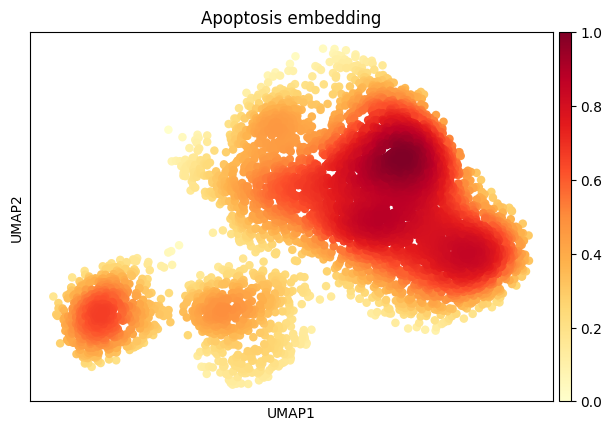

In [88]:
for comp in comp_list:
    print(comp)
    run_density_estimation(apoptosis_adata_DP, comp)

### DINO

CLADRIBINE


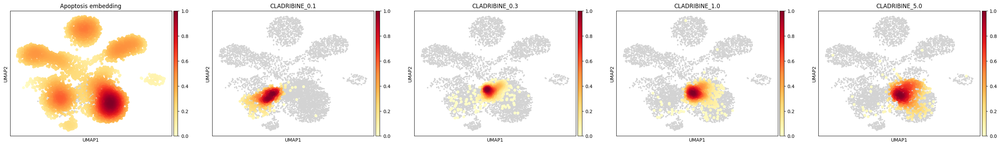

BZ 423
Skipping group 'BZ 423_1.0' as it has only 40 cells, which is below the minimum threshold of 100.


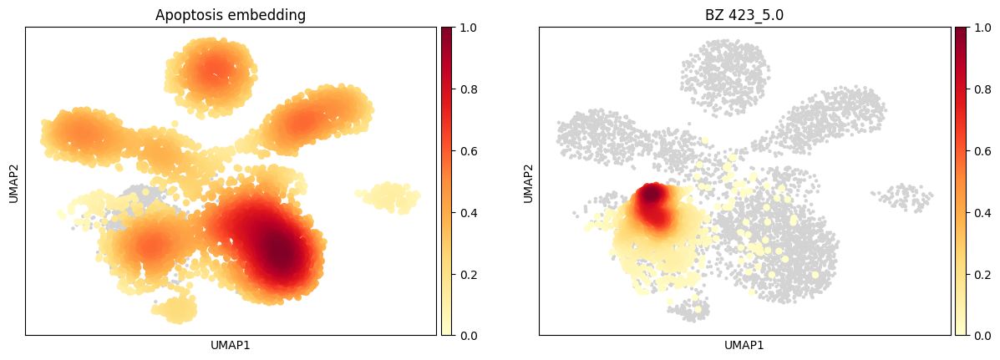

SN 38


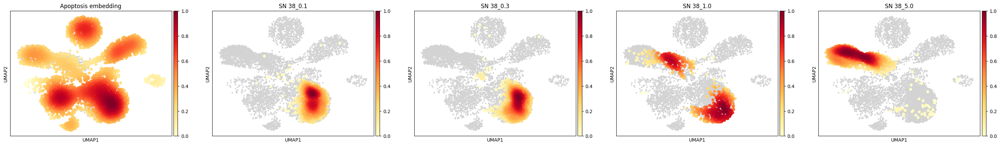

ONCRASIN 1
Skipping group 'ONCRASIN 1_5.0' as it has only 40 cells, which is below the minimum threshold of 100.


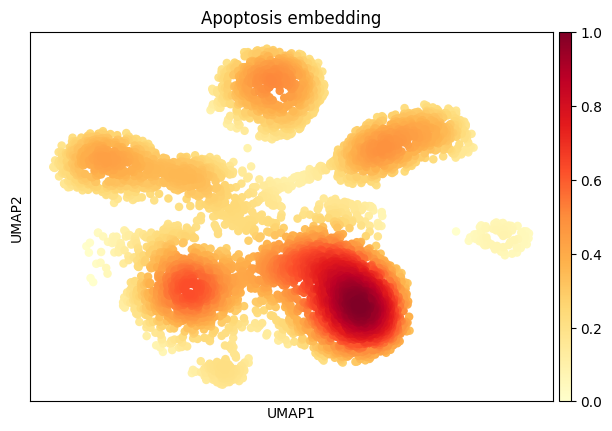

APOPTOSIS ACTIVATOR 2


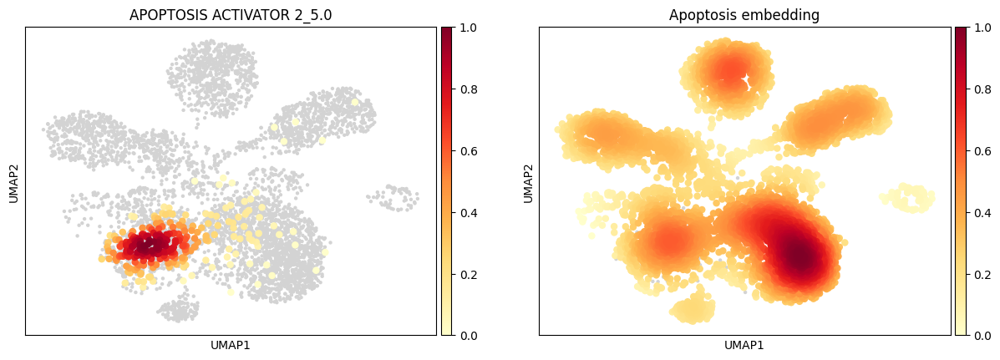

FK 866


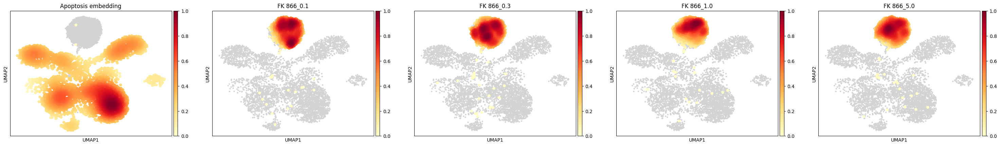

FLUDARABINE


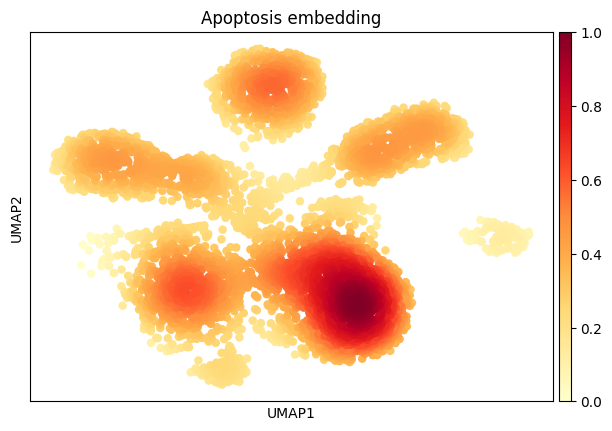

KAEMPFEROL
Skipping group 'KAEMPFEROL_0.1' as it has only 84 cells, which is below the minimum threshold of 100.


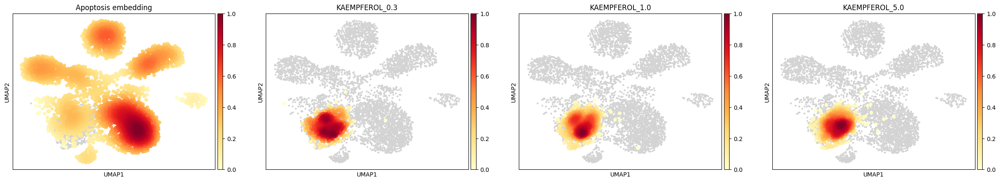

ETOPOSIDE


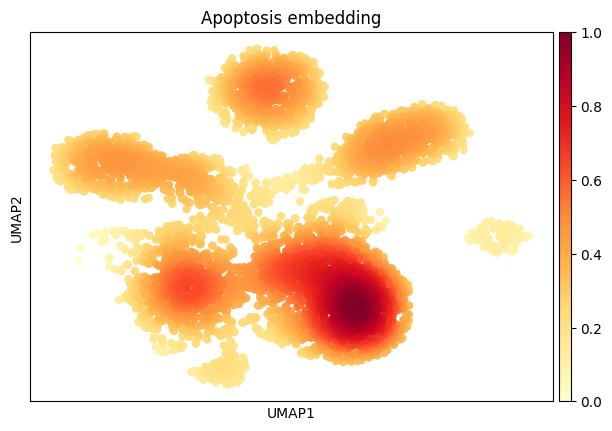

MPC 6827


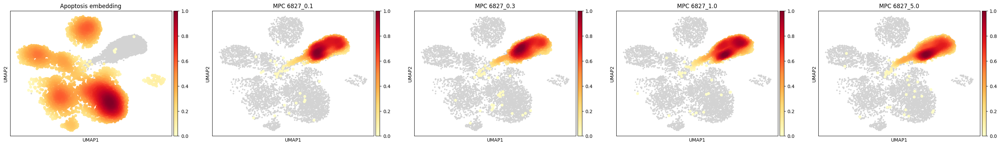

TOPOTECAN


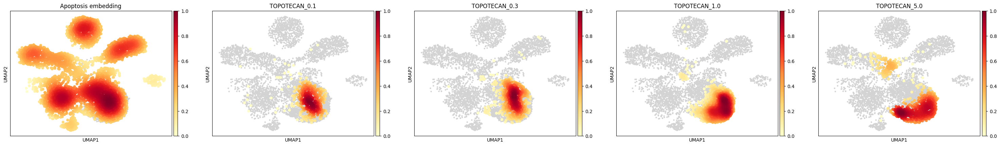

RIFAXIMIN


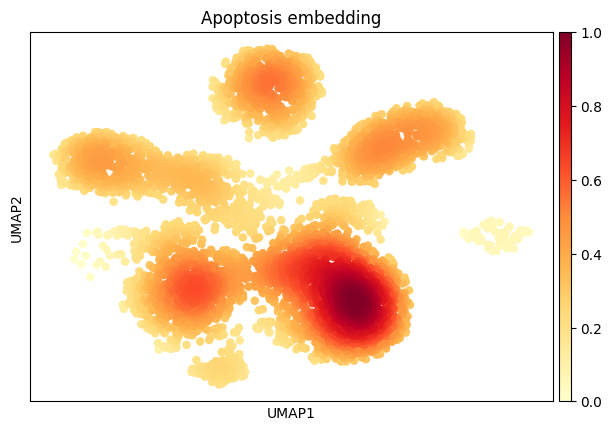

MITOMYCIN C


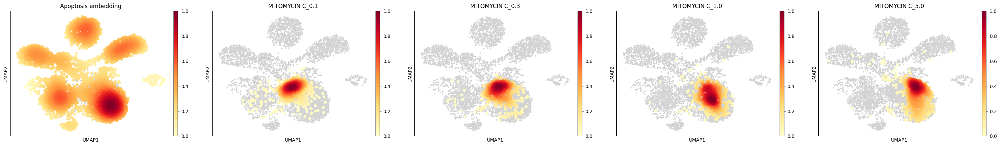

BETULINIC ACID
Skipping group 'BETULINIC ACID_0.1' as it has only 42 cells, which is below the minimum threshold of 100.


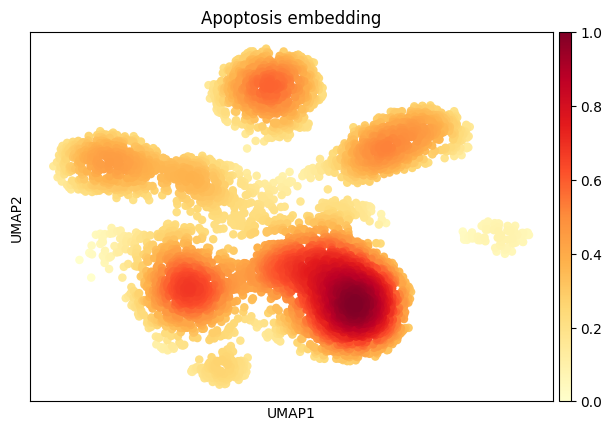

DOXORUBICIN


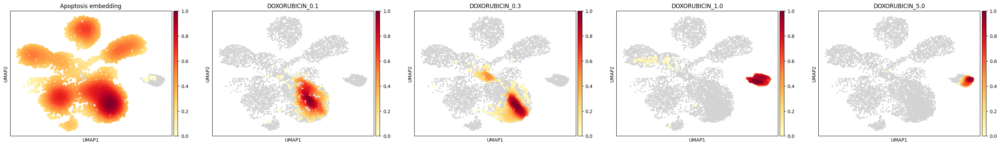

CAMPTOTHECIN


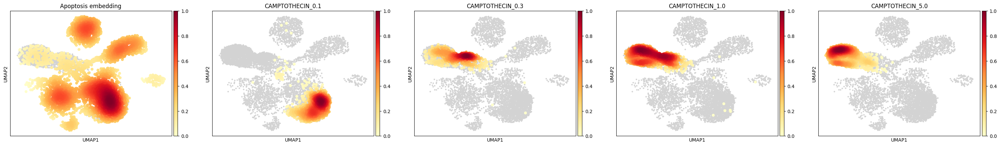

G5


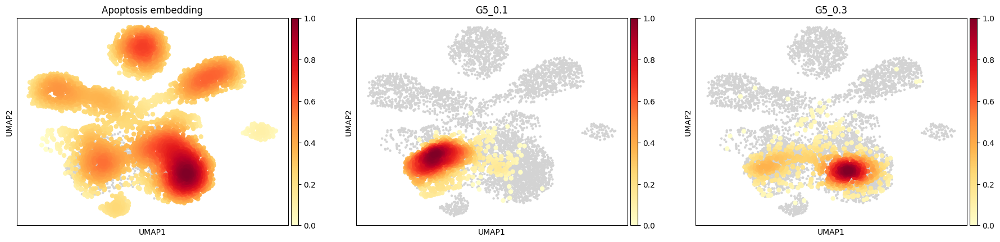

2;3-DCPE HYDROCHLORIDE


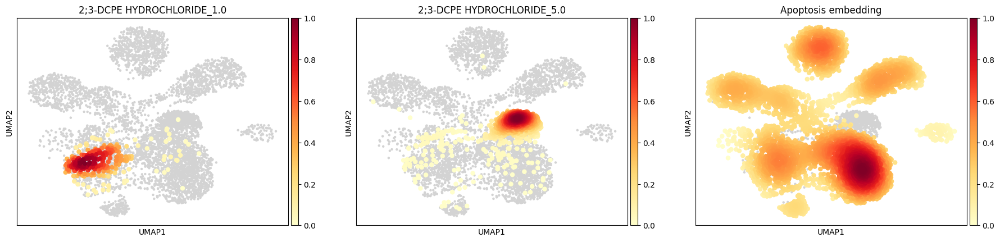

C 75


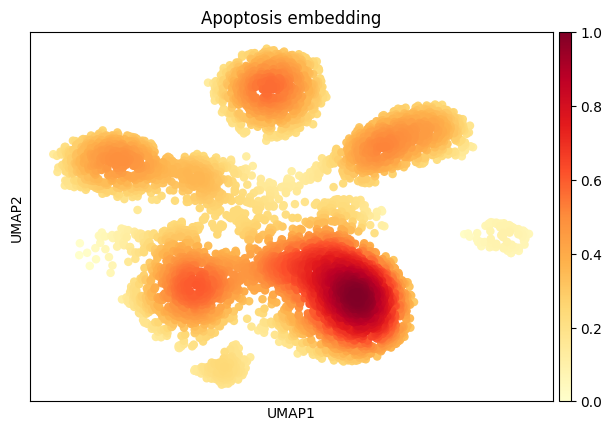

SMBA 1


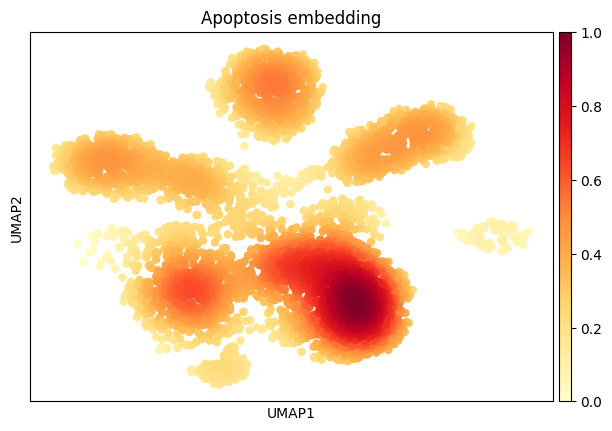

EPIRUBICIN


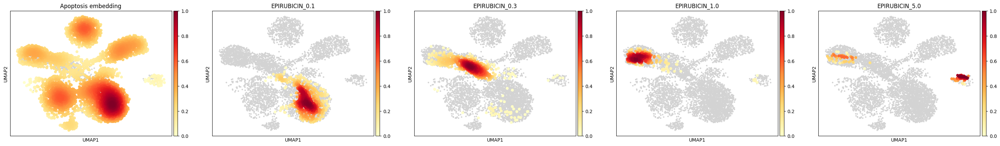

NARCICLASINE
Skipping group 'NARCICLASINE_5.0' as it has only 22 cells, which is below the minimum threshold of 100.


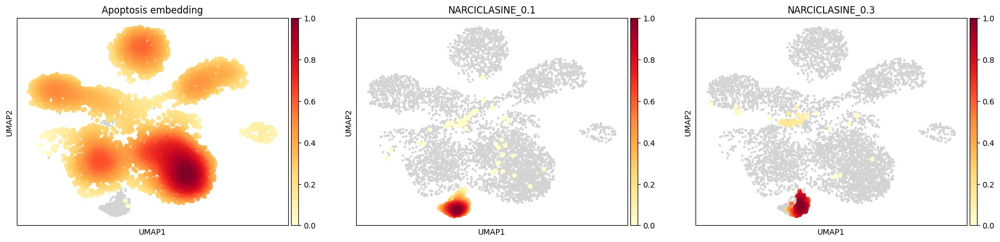

AT 101


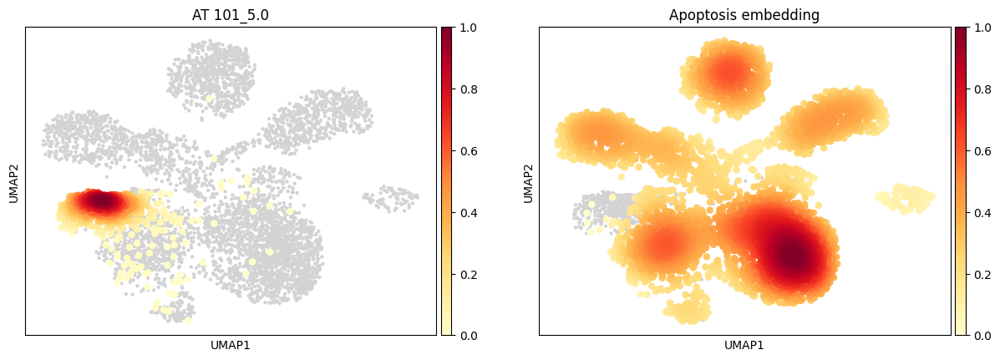

ANATOXIN A FUMARATE


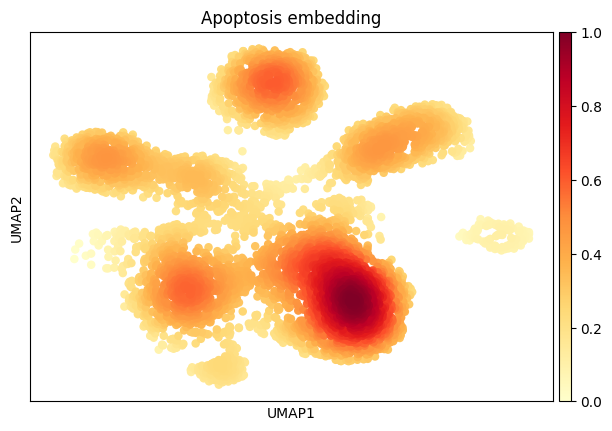

In [90]:
for comp in comp_list:
    print(comp)
    run_density_estimation(adata_apoptosis, comp)

# Correlation matrix

In [39]:
cp_aggregate_df = pd.read_parquet("/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/datasets_paper/aggregate_profiles_CP_aggregated.parquet")
dp_aggregate_df = pd.read_parquet("/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/datasets_paper/aggregate_profiles_DP_adjusted.parquet")
DINO_aggregate_df = pd.read_parquet("/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/datasets_paper/aggregate_profiles_DINO_adjusted.parquet")

In [49]:
adata_agg_DP = ad.AnnData(X = dp_aggregate_df[[feat for feat in dp_aggregate_df.columns if "Feature" in feat]], obs = dp_aggregate_df[[feat for feat in dp_aggregate_df.columns if "Feature" not in feat]])

sc.tl.pca(adata_agg_DP, svd_solver='arpack')
sc.pp.neighbors(adata_agg_DP,n_neighbors=10, n_pcs=50)
sc.tl.umap(adata_agg_DP)

adata_agg_DP.obs['id'] = (
    adata_agg_DP.obs[columns_to_concat]
    .astype(str)
    .agg('_'.join, axis=1)
    .astype('category')
)
adata_agg_DP.obs['moa'] = (
    adata_agg_DP
    .obs["moa"]
    .astype('category')
)

/usr/local/lib/python3.10/dist-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [59]:
adata_agg_CP = ad.AnnData(X = cp_aggregate_df[[feat for feat in cp_aggregate_df.columns if feat not in ["moa", "Metadata_Plate", "Metadata_Well", "Metadata_Site", "Metadata_cmpdConc", "label", "Metadata_cmpdName"]]], obs = cp_aggregate_df[[feat for feat in cp_aggregate_df.columns if feat in ["moa", "Metadata_Plate", "Metadata_Well", "Metadata_Site", "Metadata_cmpdConc", "label", "Metadata_cmpdName"]]])

sc.tl.pca(adata_agg_CP, svd_solver='arpack')
sc.pp.neighbors(adata_agg_CP,n_neighbors=10, n_pcs=50)
sc.tl.umap(adata_agg_CP)

adata_agg_CP.obs['id'] = (
    adata_agg_CP.obs[columns_to_concat]
    .astype(str)
    .agg('_'.join, axis=1)
    .astype('category')
)

/usr/local/lib/python3.10/dist-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [ ]:
adata_agg_DINO = ad.AnnData(X = DINO_aggregate_df[[feat for feat in DINO_aggregate_df.columns if feat not in ["moa", "Metadata_Plate", "Metadata_Well", "Metadata_Site", "Metadata_cmpdConc", "label", "Metadata_cmpdName"]]], obs = DINO_aggregate_df[[feat for feat in DINO_aggregate_df.columns if feat in ["moa", "Metadata_Plate", "Metadata_Well", "Metadata_Site", "Metadata_cmpdConc", "label", "Metadata_cmpdName"]]])

sc.tl.pca(DINO_aggregate_df, svd_solver='arpack')
sc.pp.neighbors(DINO_aggregate_df,n_neighbors=10, n_pcs=50)
sc.tl.umap(DINO_aggregate_df)

DINO_aggregate_df.obs['id'] = (
    DINO_aggregate_df.obs[columns_to_concat]
    .astype(str)
    .agg('_'.join, axis=1)
    .astype('category')
)

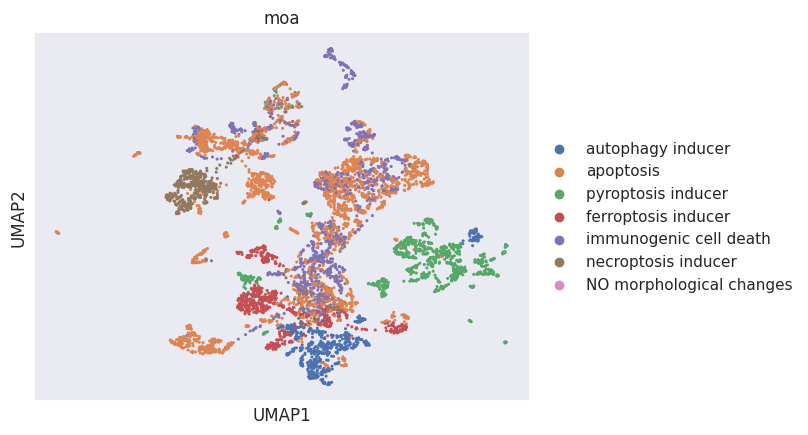

In [61]:
plot_combined_umap(adata_agg_DINO, adata_agg_DP, adata_agg_CP, color_column="Metadata_cmpdName", save_path="big_combined_umap.png")

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme()

def create_pca_df(adata, n_pcs=50):
    """
    Extract PCA coordinates and metadata from the AnnData object.
    """
    # Extract the first n_pcs PCA coordinates
    pca_coords = pd.DataFrame(adata.obsm['X_pca'][:, :n_pcs], index=adata.obs.index)
    
    # Extract relevant metadata columns ('id' and 'moa')
    pca_coords['id'] = adata.obs['id'].values
    pca_coords['moa'] = adata.obs['moa'].values
    
    return pca_coords

def correlation_heatmap(adata, save_dir):
    pca_df = pd.DataFrame(
        adata_agg.obsm['X_pca'][:, :50],  # Extract the first n_pcs components
        index=adata_agg.obs_names
    )
        
        # Add metadata columns (assuming 'id' and 'moa' are stored in adata.obs)
    pca_df['id'] = adata_agg.obs['id'].values
    pca_df['moa'] = adata_agg.obs['moa'].values.astype(str)

        # Step 2: Calculate correlation matrix between rows (IDs)
    corr_matrix = pca_df.iloc[:, :50].T.corr()

        # Step 3: Prepare color annotations for the 'moa' column
    unique_moas = pca_df['moa'].unique()
    palette = sns.color_palette("husl", len(unique_moas))
    #moa_color_map = dict(zip(unique_moas, palette))
    moa_color_map = {'autophagy inducer': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765), 'apoptosis': (1.0, 0.4980392156862745, 0.054901960784313725), 'ferroptosis inducer': (0.17254901960784313, 0.6274509803921569, 0.17254901960784313), 'immunogenic cell death': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392), 'pyroptosis inducer': (0.5803921568627451, 0.403921568627451, 0.7411764705882353), 'necroptosis inducer': (0.5490196078431373, 0.33725490196078434, 0.29411764705882354)}


        # Map colors to the 'moa' annotations
    moa_colors = pca_df['moa'].map(moa_color_map)

    g = sns.clustermap(
        corr_matrix,
        center=0,
        cmap='vlag',
        row_colors=moa_colors,
        col_colors=moa_colors,
        dendrogram_ratio=(.1, .2),
        cbar_pos=(0.02, 0.8, 0.05, 0.18),
        figsize=(12, 13)
    )
    g.ax_row_dendrogram.remove()
    g.ax_heatmap.set_xticklabels([])
    g.ax_heatmap.set_yticklabels([])

    # Optionally, remove axis labels entirely
    g.ax_heatmap.set_xlabel("")
    g.ax_heatmap.set_ylabel("")
    plt.savefig(save_dir, dpi=300, bbox_inches='tight')
    plt.show()


In [ ]:
correlation_heatmap(adata_agg_DINO, "/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/figures/correlations_DINO.png")

In [ ]:
correlation_heatmap(adata_agg_cp, "/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/figures/correlations_CP.png")


In [ ]:
correlation_heatmap(adata_agg_dp, "/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/figures/correlations_DP.png")


# Grit calculation

In [7]:
import polars as pl
from grit_script import *
import tqdm

In [19]:
df_X = pd.DataFrame(adata_combined.X.toarray(), index=adata_combined.obs_names, columns=adata_combined.var_names)
df_obs = adata_combined.obs.copy()
df_combined = pd.concat([df_obs, df_X], axis=1).reset_index(drop=True)


In [21]:
#df_combined = df_combined.iloc[:, 1:].reset_index(drop = True)
df_combined = df_combined.apply(lambda col: col.astype(str) if col.dtype.name == 'category' else col)


In [24]:
df_combined.columns = [col if i < 13 else f'Feature_{i-13}' for i, col in enumerate(df_combined.columns)]
feature_df = pl.DataFrame(df_combined)

In [26]:
features_fixed = [feat for feat in feature_df.columns if "Feature" in feat]
feature_df_agg = (
feature_df.group_by(["moa", "Metadata_Plate", 'Metadata_Well', 'Metadata_cmpdName', "Metadata_cmpdConc", "Metadata_Site"])
    .agg([pl.col(feature).median().alias(feature) for feature in features_fixed])
)
feature_df_agg = feature_df_agg.with_columns((pl.col("Metadata_cmpdName") + "_" + pl.col("Metadata_cmpdConc").cast(pl.Utf8) + "_" + pl.col("Metadata_Well") + "_" + pl.col("Metadata_Site")).alias("compound_replicate"))

In [27]:
feature_df_agg = feature_df_agg.with_columns(
    pl.concat_str(
        [pl.col("Metadata_cmpdName"), pl.col("Metadata_cmpdConc")],
        separator="_"
    ).alias("Metadata_cmpdConcName")
)

In [28]:
def compute_grit(dfZscores):
    plates = list(dfZscores["Metadata_Plate"].unique())
    features_fixed = [feat for feat in dfZscores.columns if "Feature" in feat]
    meta_features = [feat for feat in dfZscores.columns if feat not in features_fixed]
    grit_score_list = []
    for p in tqdm.tqdm(plates): 
        profiles = dfZscores[dfZscores["Metadata_Plate"] == p]
        grit_scores = evaluate(
                profiles=profiles,  
                features=features_fixed,
                meta_features=meta_features,   
                replicate_groups={"profile_col": "compound_replicate", "replicate_group_col": "Metadata_cmpdConcName"},
                operation="grit",
                similarity_metric="pearson",
                grit_replicate_summary_method="median", # median
                grit_control_perts=profiles.query("Metadata_cmpdConcName == 'DIMETHYL SULFOXIDE_0.1'").compound_replicate.unique().tolist()
            ).assign(p = p)
        grit_score_list.append(grit_scores)
    return grit_score_list

In [29]:
grits_aggregated = compute_grit(feature_df_agg.to_pandas())


  0%|          | 0/8 [00:00<?, ?it/s]

Generating correlation matrix
Now calculating corelation matrix
(1724, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 12%|█▎        | 1/8 [00:23<02:41, 23.14s/it]

Generating correlation matrix
Now calculating corelation matrix
(1805, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 25%|██▌       | 2/8 [00:54<02:48, 28.02s/it]

Generating correlation matrix
Now calculating corelation matrix
(1702, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 38%|███▊      | 3/8 [01:17<02:09, 25.88s/it]

Generating correlation matrix
Now calculating corelation matrix
(1520, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 50%|█████     | 4/8 [01:36<01:32, 23.17s/it]

Generating correlation matrix
Now calculating corelation matrix
(1581, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 62%|██████▎   | 5/8 [01:59<01:09, 23.01s/it]

Generating correlation matrix
Now calculating corelation matrix
(1786, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 75%|███████▌  | 6/8 [02:24<00:47, 23.68s/it]

Generating correlation matrix
Now calculating corelation matrix
(1790, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


 88%|████████▊ | 7/8 [02:51<00:24, 24.69s/it]

Generating correlation matrix
Now calculating corelation matrix
(1945, 384)
Now melting datafdrame
Melting to long
Merging meta with correlations
Now starting grit calculation


100%|██████████| 8/8 [03:23<00:00, 25.50s/it]


In [30]:
grit_scores_total = pd.concat(grits_aggregated)
grit_compound_final = grit_scores_total.groupby("group").mean("grit").reset_index()
grit_filtered_1 = grit_scores_total[grit_scores_total["grit"] > 1.5]
#grit_filtered.to_csv("grit_over1.5_specs5k_moa.csv")
grit_filtered_1["filter"] = grit_filtered_1["perturbation"] + "_" + grit_filtered_1["p"]
grit_comps = list(grit_filtered_1["filter"])

/tmp/ipykernel_724677/1251569429.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grit_filtered_1["filter"] = grit_filtered_1["perturbation"] + "_" + grit_filtered_1["p"]


In [31]:
grit_scores_total.to_csv("grit_allsites_DINO.csv")

In [32]:
grit_compound_final.to_csv("grit_all_cmpdconc_beactica_DINO.csv")

In [33]:
feature_df = feature_df.with_columns((pl.col("Metadata_cmpdName") + "_" + pl.col("Metadata_cmpdConc").cast(pl.Utf8) + "_" + pl.col("Metadata_Well") + "_" + pl.col("Metadata_Site") + "_" + pl.col("Metadata_Plate")).alias("filter"))

In [34]:
feature_df_filter = feature_df.filter(pl.col("filter").is_in(grit_comps))

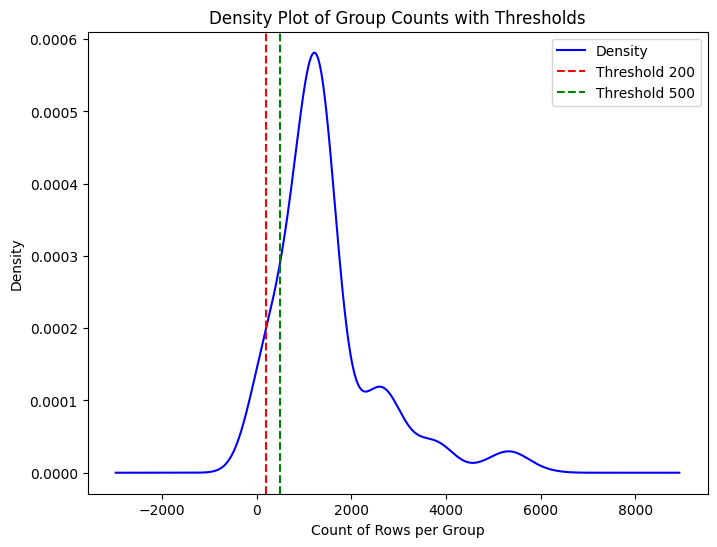

Percentage of groups with counts below 200: 7.17%
Percentage of groups with counts below 500: 13.40%


In [35]:
group_counts = feature_df.filter(pl.col("Metadata_cmpdName") != "DIMETHYL SULFOXIDE").to_pandas().groupby('Metadata_cmpdNameConc').size()

plt.figure(figsize=(8, 6))
group_counts.plot(kind='density', color='blue', label='Density')

# Draw vertical lines at 200 and 500
plt.axvline(x=200, color='red', linestyle='--', label='Threshold 200')
plt.axvline(x=500, color='green', linestyle='--', label='Threshold 500')

# Calculate total number of groups
total_groups = len(group_counts)

# Calculate how many groups have counts below 200 and 500 as percentages
below_200_count = (group_counts < 200).sum()
below_500_count = (group_counts < 500).sum()

below_200_percentage = (below_200_count / total_groups) * 100
below_500_percentage = (below_500_count / total_groups) * 100

# Add labels, legend, and title
plt.xlabel('Count of Rows per Group')
plt.ylabel('Density')
plt.title('Density Plot of Group Counts with Thresholds')
plt.legend()

# Show the plot
plt.show()

# Print the percentage of groups below 200 and 500
print(f"Percentage of groups with counts below 200: {below_200_percentage:.2f}%")
print(f"Percentage of groups with counts below 500: {below_500_percentage:.2f}%")

# Training data split

## Same for all feature sets

In [2]:
sc_profiles = pl.read_parquet("/home/jovyan/share/data/analyses/benjamin/DINO/CELLDEATH/datasets_paper/sc_profiles_filtered_DINO.parquet")

In [37]:
import random
import polars as pl

random.seed(69)

def well_split(df, moa_column='moa', train_frac=0.6, test_frac=0.2, val_frac=0.2):
    # Remove unused categories from the 'moa' column
    df = df.with_columns(pl.col(moa_column).cast(pl.Categorical).cast(pl.Categorical))

    # Get unique MOA categories
    moa_broad = df.select(moa_column).unique().to_series().to_list()

    train_list = []
    valid_list = []
    test_list = []

    for m in moa_broad:
        moa_df = df.filter(pl.col(moa_column) == m)

        # Group by compound and wells
        moa_grouped = moa_df.group_by(["moa", "Metadata_cmpdName", "Metadata_Well", "Metadata_Plate"]).agg(
            pl.count().alias('Compound Count')
        )

        # Calculate compound fraction
        total_count = moa_grouped['Compound Count'].sum()
        moa_grouped = moa_grouped.with_columns(
            (pl.col('Compound Count') / total_count).alias('Compound fraction')
        )

        # Shuffle rows
        moa_grouped = moa_grouped.sample(fraction=1, seed=42)

        current_train_sum = 0
        current_valid_sum = 0

        for row in moa_grouped.iter_rows():
            if current_train_sum < train_frac:
                train_list.append(row)
                current_train_sum += row[-1]  # Compound fraction
            elif current_valid_sum < val_frac:
                valid_list.append(row)
                current_valid_sum += row[-1]  # Compound fraction
            else:
                test_list.append(row)

    # Convert lists to DataFrames
    train_df = pl.DataFrame(train_list, schema=moa_grouped.schema)
    valid_df = pl.DataFrame(valid_list, schema=moa_grouped.schema)
    test_df = pl.DataFrame(test_list, schema=moa_grouped.schema)

    # Add split labels
    train_df = train_df.with_columns(pl.lit("training").alias("split"))
    valid_df = valid_df.with_columns(pl.lit("valid").alias("split"))
    test_df = test_df.with_columns(pl.lit("test").alias("split"))

    # Combine all into one final DataFrame
    full_split = pl.concat([train_df, valid_df, test_df])

    return full_split, moa_grouped, moa_df



In [38]:
full_split, moa_grouped, moa_df = well_split(sc_profiles)


/tmp/ipykernel_1521233/1503255239.py:22: DeprecationWarning: `pl.count()` is deprecated. Please use `pl.len()` instead.
  pl.count().alias('Compound Count')
/usr/lib/python3.10/functools.py:889: DataOrientationWarning: Row orientation inferred during DataFrame construction. Explicitly specify the orientation by passing `orient="row"` to silence this warning.
  return dispatch(args[0].__class__)(*args, **kw)


In [39]:
def split_dataframe(input_df, split_df):
    # Ensure the split_df DataFrame has the necessary columns
    required_columns = {"Metadata_cmpdName", "Metadata_Well", "Metadata_Plate", "split"}
    if not required_columns.issubset(split_df.columns):
        raise ValueError(f"Split DataFrame must have columns: {required_columns}")
    input_df = input_df.with_columns([
    pl.col(pl.Categorical).cast(pl.Utf8)  # Convert all columns of type 'Categorical' to 'Utf8' (string)
    ])
    # Join the input DataFrame with the split DataFrame on 'Metadata_cmpdName', 'Metadata_Well', and 'Metadata_Plate'
    merged_df = input_df.join(
        split_df, on=["Metadata_cmpdName", "Metadata_Well", "Metadata_Plate"], how="inner"
    )

    # Perform the split based on the 'split' column in the merged DataFrame
    train_df = merged_df.filter(pl.col("split") == "training")
    valid_df = merged_df.filter(pl.col("split") == "valid")
    test_df = merged_df.filter(pl.col("split") == "test")
    
    return train_df, valid_df, test_df

In [40]:
train_df_DP, valid_df_DP, test_df_DP = split_dataframe(sc_profiles, full_split)

# Target analysis

In [11]:
import pandas as pd

# Create the initial DataFrame
data = {
    "Compound": [
        "2;3-DCPE Hydrochloride", "Anatoxin A Fumarate", "Apoptosis Activator 2", 
        "AT 101", "Betulinic Acid", "BZ 423", "C75", "Camptothecin", "Cladribine", 
        "Doxorubicin", "Epirubicin", "Etoposide", "FK 866", "Fludarabine", "G5", 
        "Kaempferol", "Mitomycin C", "MPC 6827", "Narciclasine", "Oncrasin 1", 
        "Rifaximin", "SMBA 1", "SN 38", "Topotecan"
    ],
    "Mechanism of Action": [
        "Downregulates Bcl-XL protein expression.", "Agonist of nicotinic acetylcholine receptors (nAChRs).", 
        "Induces apoptosis selectively in tumor cells.", "Downregulates Bcl-2 and Mcl-1 proteins.", 
        "Directly affects mitochondria to release cytochrome c.", "Inhibits ATP synthase to induce apoptosis.", 
        "Inhibits fatty acid synthase (FASN).", "Inhibits DNA topoisomerase I.", 
        "Incorporates into DNA, inhibiting synthesis.", "Intercalates into DNA and inhibits topoisomerase II.", 
        "Similar to doxorubicin; inhibits topoisomerase II.", "Inhibits topoisomerase II, causing DNA strand breaks.", 
        "Inhibits NAMPT, depleting NAD+ levels.", "Inhibits DNA polymerase and ribonucleotide reductase.", 
        "Ubiquitin isopeptidase inhibitor; induces apoptosis", 
        "Modulates Bcl-2 family proteins to induce apoptosis.", "Alkylates DNA, causing cross-linking.", 
        "Antineoplastic; a small-molecule inhibitor of microtubule formation that is not a substrate for multidrug resistance pumps.", 
        "Inhibits eEF1A to block protein synthesis.", "Induces apoptosis in mutated KRAS cancer cells.", 
        "Binds bacterial RNA polymerase, inhibiting RNA synthesis.", 
        "High affinity and selective activator of Bax", "Inhibits topoisomerase I, causing DNA damage.", 
        "Inhibits topoisomerase I, causing DNA strand breaks."
    ],
    "Target": [
        "Bcl-XL", "nAChRs", "APAF-1", "Bcl-2", "Mitochondria", "ATP Synthase", "FASN", 
        "Topoisomerase I", "DNA Polymerase", "Topoisomerase II", "Topoisomerase II", 
        "Topoisomerase II", "NAMPT", "DNA Polymerase", "Ubiquitin isopeptidase", 
        "Bcl-2", "DNA", "TUBB", "eEF1A", "RNA Polymerase II", "RNA Polymerase", 
        "BAX (Bcl-2)", "Topoisomerase I", "Topoisomerase I"
    ]
}

# Convert to DataFrame
compound_df = pd.DataFrame(data)

# Convert "Compound" column to uppercase
compound_df["Metadata_cmpdName"] = compound_df["Compound"].str.upper()

# Rename "Mechanism of Action" column to "Description"
compound_df.rename(columns={"Mechanism of Action": "Description"}, inplace=True)

# Assume `adata` is your existing AnnData object
# Merge compound DataFrame into the obs attribute of adata
# Ensure obs has a corresponding "Compound" column for the merge
def merge_with_obs(adata, compound_df):
    if "Metadata_cmpdName" not in adata.obs:
        raise ValueError("The 'Compound' column must exist in `adata.obs` to perform the merge.")
    # Convert "Compound" in obs to uppercase for merging
    adata.obs["Metadata_cmpdName"] = adata.obs["Metadata_cmpdName"].str.upper()
    # Merge the data
    adata.obs = adata.obs.merge(compound_df, on="Metadata_cmpdName", how="left")
    return adata

# Apply the merge function (uncomment to run when `adata` exists)
# adata = merge_with_obs(adata, compound_df)

# Display the modified DataFrame
compound_df


,Compound,Description,Target,Metadata_cmpdName
0,2;3-DCPE Hydrochloride,Downregulates Bcl-XL protein expression.,Bcl-XL,2;3-DCPE HYDROCHLORIDE
1,Anatoxin A Fumarate,Agonist of nicotinic acetylcholine receptors (...,nAChRs,ANATOXIN A FUMARATE
2,Apoptosis Activator 2,Induces apoptosis selectively in tumor cells.,APAF-1,APOPTOSIS ACTIVATOR 2
3,AT 101,Downregulates Bcl-2 and Mcl-1 proteins.,Bcl-2,AT 101
4,Betulinic Acid,Directly affects mitochondria to release cytoc...,Mitochondria,BETULINIC ACID
5,BZ 423,Inhibits ATP synthase to induce apoptosis.,ATP Synthase,BZ 423
6,C75,Inhibits fatty acid synthase (FASN).,FASN,C75
7,Camptothecin,Inhibits DNA topoisomerase I.,Topoisomerase I,CAMPTOTHECIN
8,Cladribine,"Incorporates into DNA, inhibiting synthesis.",DNA Polymerase,CLADRIBINE
9,Doxorubicin,Intercalates into DNA and inhibits topoisomera...,Topoisomerase II,DOXORUBICIN


In [32]:
adata_apoptosis_DINO = merge_with_obs(adata_apoptosis_DINO, compound_df)
adata_apoptosis_DINO = adata_apoptosis_DINO[~adata_apoptosis_DINO.obs["Target"].isin(["Mitochondria"])].copy()


/home/jovyan/share/data/analyses/benjamin/.venv/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [25]:
apoptosis_adata_DP = merge_with_obs(apoptosis_adata_DP, compound_df)

In [26]:
apoptosis_adata_CP = merge_with_obs(apoptosis_adata_CP, compound_df)

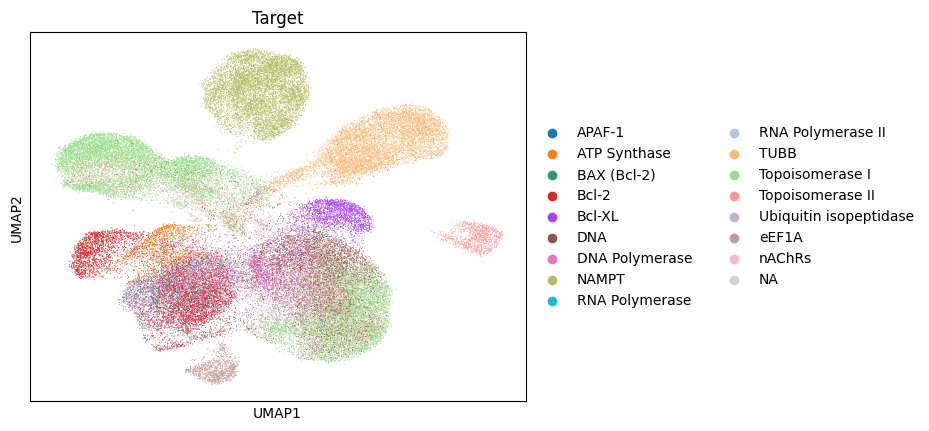

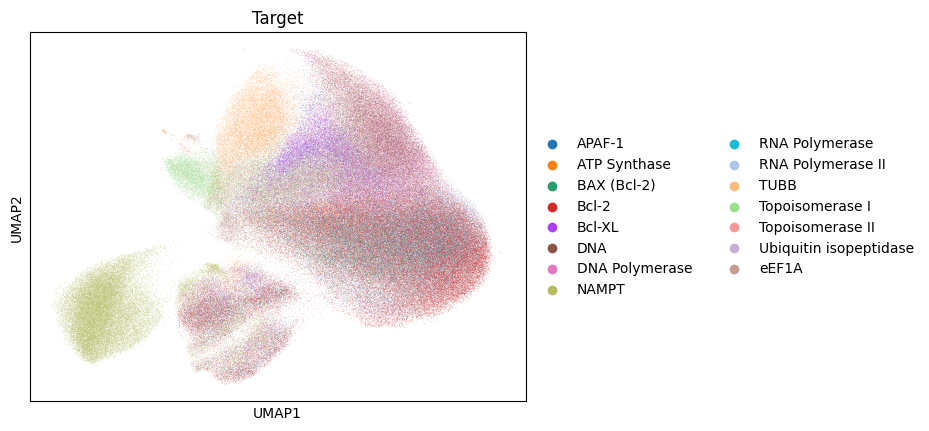

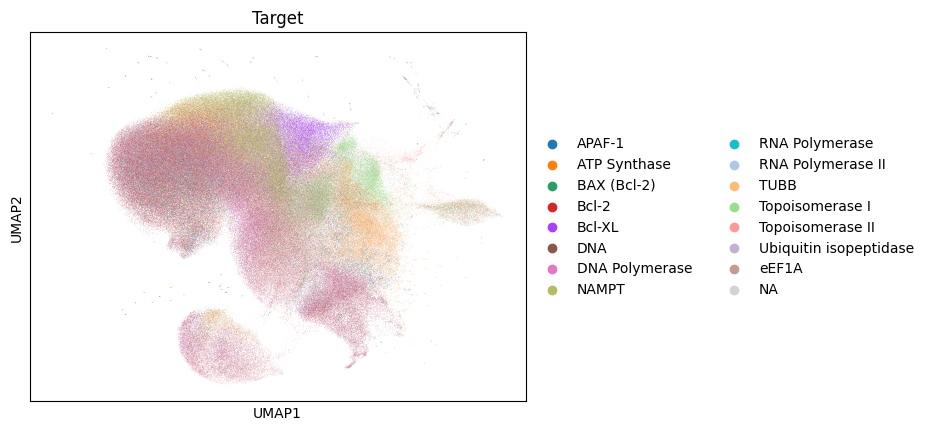

In [36]:
sc.pl.umap(adata_apoptosis, color ="Target")
sc.pl.umap(apoptosis_adata_DP, color ="Target")
sc.pl.umap(apoptosis_adata_CP, color ="Target")


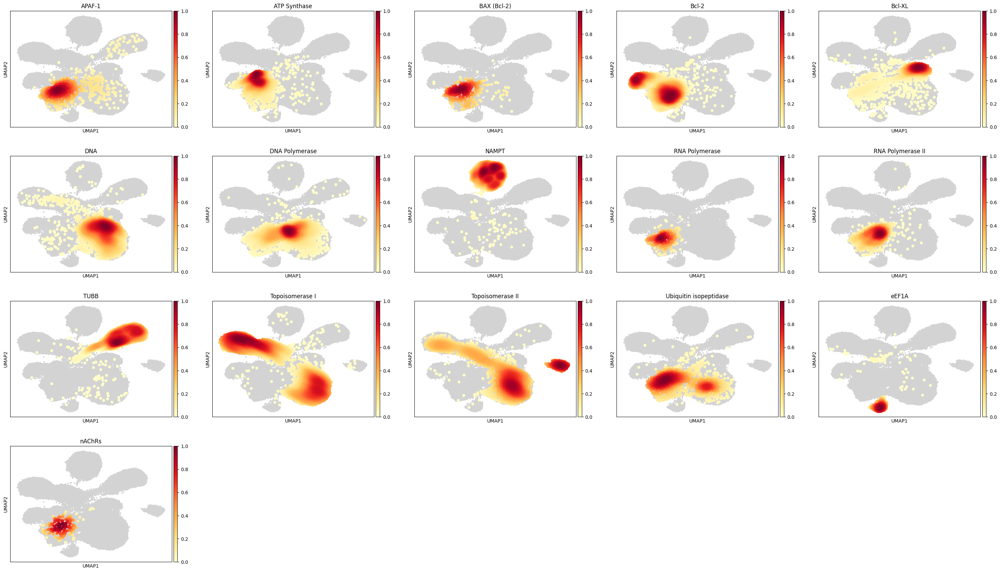

In [37]:
sc.tl.embedding_density(adata_apoptosis, basis='umap', groupby='Target')
sc.pl.embedding_density(adata_apoptosis, bg_dotsize = 40, fg_dotsize= 150, basis='umap', ncols = 5, key='umap_density_Target')

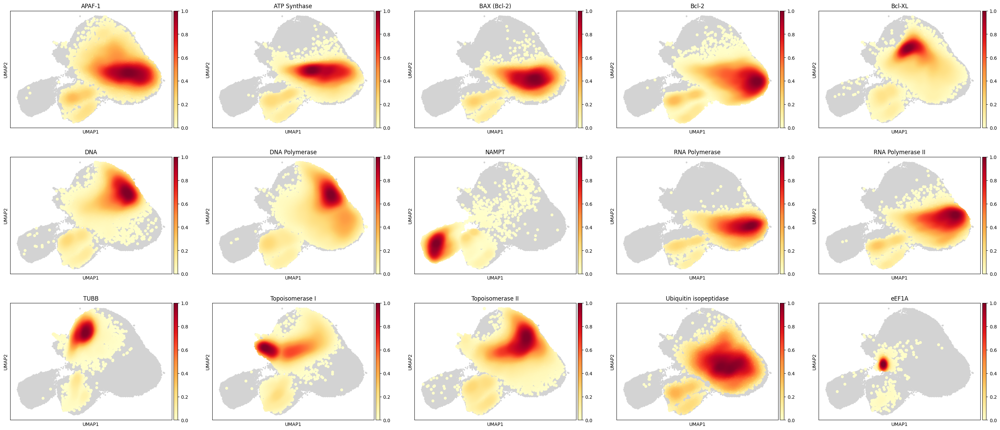

In [34]:
sc.tl.embedding_density(apoptosis_adata_DP, basis='umap', groupby='Target')
sc.pl.embedding_density(apoptosis_adata_DP, bg_dotsize = 40, fg_dotsize= 150, basis='umap', ncols = 5, key='umap_density_Target')

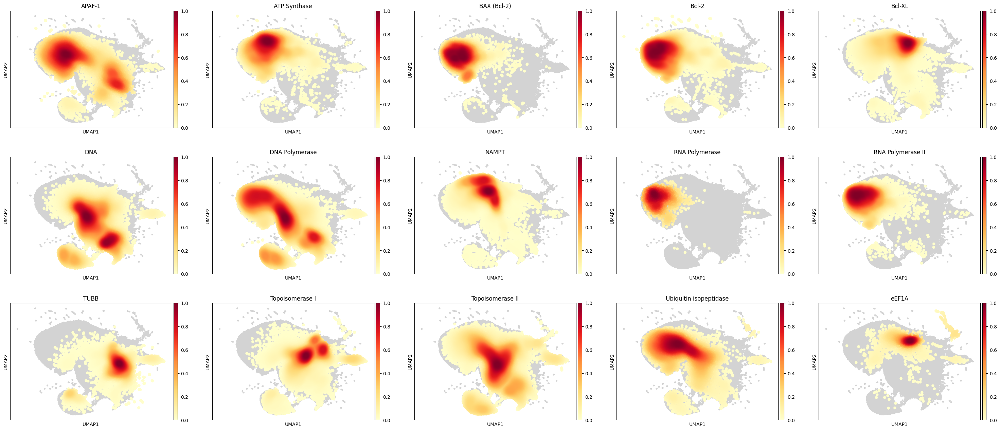

In [35]:
sc.tl.embedding_density(apoptosis_adata_CP, basis='umap', groupby='Target')
sc.pl.embedding_density(apoptosis_adata_CP, bg_dotsize = 40, fg_dotsize= 150, basis='umap', ncols = 5, key='umap_density_Target')

## Target analysis all comps

In [1]:
import pandas as pd

table_data = {
    "Compound": [
        "Etoposide", "Betulinic Acid", "Apoptosis Activator 2", "Anatoxin A Fumarate", 
        "2;3-DCPE Hydrochloride", "AT 101", "AZD 2461", "Bleomycin", "Bortezomib",
        "BZ 423", "Camptothecin", "Carboplatin", "C 75", "Cisplatin", "Cladribine",
        "Crizotinib", "DACTINOMYCIN (ACTINOMYCIN D)", "Daunorubicin", "Doxorubicin", "Domperidone",
        "Epirubicin", "Erastin", "Everolimus", "FIN 56", "FK 866", "Fludarabine",
        "G5", "HS-173", "Kaempferol", "L-690,330", "Lovastatin", "Loperamide",
        "Mitomycin C", "MPC 6827", "Narciclasine", "Nigericin", "Oncrasin 1",
        "Oxaliplatin", "Pimozide", "Polyphyllin VI", "Pravastatin", "Rifaximin",
        "Shikonin", "Simvastatin", "SMBA 1", "SN 38", "Sorafenib", "Sulfasalazine",
        "Teniposide", "Topotecan", "VU0359595"
    ],
    "Description": [
        "Inhibits topoisomerase II, causing DNA strand breaks.", 
        "Directly affects mitochondria to release cytochrome c.",
        "Induces apoptosis selectively in tumor cells.",
        "Agonist of nicotinic acetylcholine receptors (nAChRs).",
        "Downregulates Bcl-XL protein expression.",
        "Downregulates Bcl-2 and Mcl-1 proteins.",
        "Inhibits PARP, leading to DNA damage accumulation.",
        "Induces DNA strand breaks, leading to apoptosis.",
        "Inhibits the 26S proteasome, leading to apoptosis in cancer cells.",
        "Inhibits ATP synthase to induce apoptosis.",
        "Inhibits topoisomerase I, causing DNA damage.",
        "Forms DNA cross-links, leading to apoptosis.",
        "Inhibits fatty acid synthase (FASN).",
        "Forms DNA cross-links, leading to apoptosis.",
        "Incorporates into DNA, inhibiting synthesis.",
        "Inhibits ALK, ROS1, and MET tyrosine kinases, reducing tumor cell proliferation.",
        "Binds to DNA, inhibiting RNA synthesis.",
        "Intercalates into DNA, inhibiting macromolecular biosynthesis.",
        "Intercalates into DNA and inhibits topoisomerase II.",
        "Antagonist of dopamine D₂ and D₃ receptors, enhancing gastrointestinal motility.",
        "Similar to doxorubicin; inhibits topoisomerase II.",
        "Induces ferroptosis by inhibiting the cystine/glutamate antiporter system Xc⁻.",
        "Inhibits the mammalian target of rapamycin (mTOR), affecting cell growth and proliferation.",
        "Induces ferroptosis by promoting degradation of GPX4 and depleting coenzyme Q₁₀.",
        "Inhibits NAMPT, depleting NAD⁺ levels.",
        "Inhibits DNA polymerase and ribonucleotide reductase.",
        "Ubiquitin isopeptidase inhibitor; induces apoptosis.",
        "Inhibits phosphatidylinositol 3-kinase (PI3K), leading to suppression of the PI3K/Akt signaling pathway.",
        "Modulates Bcl-2 family proteins to induce apoptosis.",
        "Inhibits inositol monophosphatase, affecting phosphatidylinositol signaling.",
        "Inhibits HMG-CoA reductase, reducing cholesterol synthesis.",
        "Agonist of peripheral μ-opioid receptors, reducing gastrointestinal motility.",
        "Alkylates DNA, causing cross-linking.",
        "Inhibits microtubule formation, inducing apoptosis.",
        "Inhibits eEF1A to block protein synthesis.",
        "Acts as an ionophore, facilitating the exchange of potassium (K⁺) and hydrogen (H⁺) ions across biological membranes.",
        "Induces apoptosis in mutated KRAS cancer cells.",
        "Forms DNA cross-links, inhibiting DNA replication and transcription.",
        "Antagonist of dopamine receptors, leading to decreased dopamine activity.",
        "Induces apoptosis through mitochondrial pathways and modulates various signaling pathways.",
        "Inhibits HMG-CoA reductase, reducing cholesterol synthesis.",
        "Binds bacterial RNA polymerase, inhibiting RNA synthesis.",
        "Inhibits tumor growth by suppressing the STAT3 signaling pathway and inducing apoptosis.",
        "Inhibits HMG-CoA reductase, reducing cholesterol synthesis.",
        "High affinity and selective activator of Bax.",
        "Inhibits topoisomerase I, causing DNA damage.",
        "Inhibits multiple tyrosine protein kinases, leading to reduced tumor cell proliferation.",
        "Inhibits NF-κB activity and acts as an anti-inflammatory agent.",
        "Inhibits topoisomerase II, leading to DNA strand breaks.",
        "Inhibits topoisomerase I, causing DNA strand breaks.",
        "Positive allosteric modulator of M1 muscarinic acetylcholine receptors, enhancing receptor activity."
    ],
    "Target": [
        "Topoisomerase II", "Mitochondria", "APAF-1", "nAChRs", "Bcl-XL", "Bcl-2", "PARP", "DNA",
        "26S Proteasome", "ATP Synthase", "Topoisomerase I", "DNA", "FASN", "DNA", "DNA Polymerase",
        "ALK, ROS1, MET", "DNA", "Topoisomerase II", "Topoisomerase II", "Dopamine Receptors",
        "Topoisomerase II", "System Xc⁻", "mTOR", "GPX4", "NAMPT", "DNA Polymerase",
        "Ubiquitin Isopeptidase", "PI3K", "Bcl-2", "Inositol Monophosphatase", "HMG-CoA Reductase",
        "μ-Opioid Receptors", "DNA", "TUBB", "eEF1A", "Ion Transport", "KRAS",
        "DNA", "Dopamine Receptors", "Apoptosis Pathways", "HMG-CoA Reductase", "RNA Polymerase",
        "STAT3", "HMG-CoA Reductase", "BAX (Bcl-2)", "Topoisomerase I", "Tyrosine Kinases", "NF-κB",
        "Topoisomerase II", "Topoisomerase I", "M1 Muscarinic Receptors"
    ]
}
table_df = pd.DataFrame(table_data)
table_df["Metadata_cmpdName"] = table_df["Compound"].str.upper()

In [3]:
def merge_with_obs(adata, compound_df):
    if "Metadata_cmpdName" not in adata.obs:
        raise ValueError("The 'Compound' column must exist in `adata.obs` to perform the merge.")
    # Convert "Compound" in obs to uppercase for merging
    adata.obs["Metadata_cmpdName"] = adata.obs["Metadata_cmpdName"].str.upper()
    # Merge the data
    adata.obs = adata.obs.merge(compound_df, on="Metadata_cmpdName", how="left")
    return adata

In [10]:
adata_filter_grit = merge_with_obs(adata_filter_grit, table_df)

In [15]:
adata_filter_grit.obs[["Metadata_cmpdName", "Target", "moa"]].drop_duplicates()

,Metadata_cmpdName,Target,moa
0,BLEOMYCIN,DNA,immunogenic cell death
158,DAUNORUBICIN,Topoisomerase II,immunogenic cell death
226,NIGERICIN,Ion Transport,pyroptosis inducer
441,FIN 56,GPX4,ferroptosis inducer
538,DOXORUBICIN,Topoisomerase II,apoptosis
623,POLYPHYLLIN VI,Apoptosis Pathways,pyroptosis inducer
800,SHIKONIN,STAT3,necroptosis inducer
971,EPIRUBICIN,Topoisomerase II,apoptosis
1604,ERASTIN,System Xc⁻,ferroptosis inducer
1631,EVEROLIMUS,mTOR,autophagy inducer


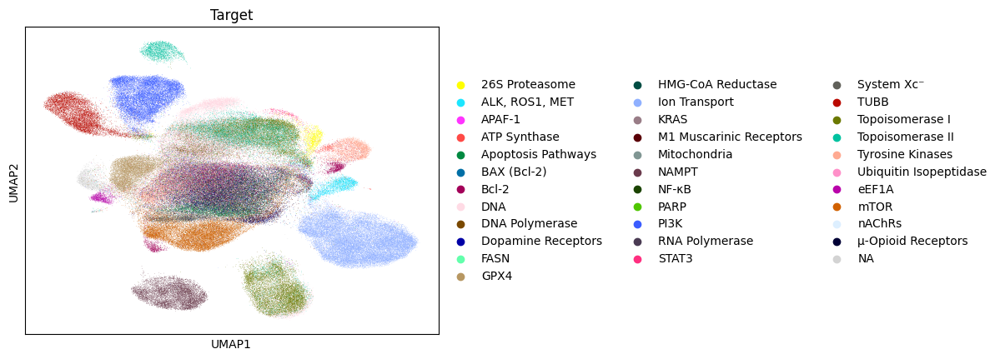

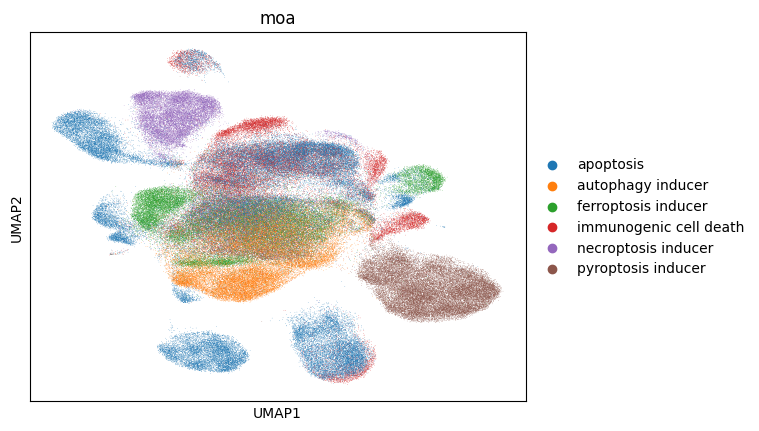

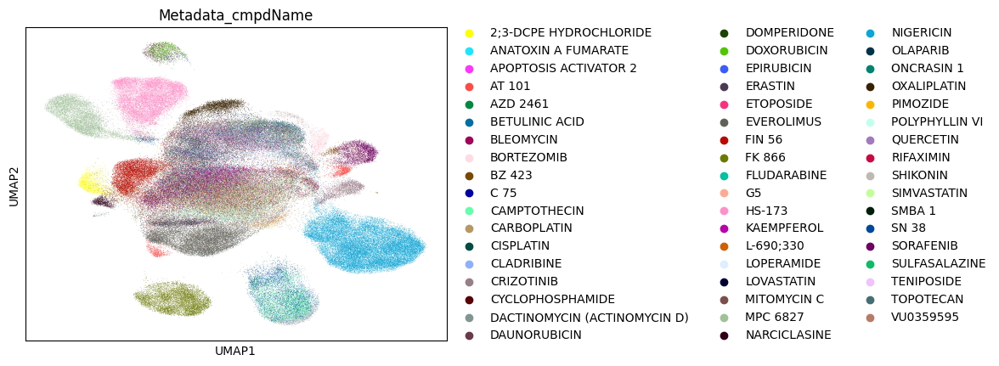

In [16]:
sc.pl.umap(adata_filter_grit, color ="Target")
sc.pl.umap(adata_filter_grit, color ="moa")
sc.pl.umap(adata_filter_grit, color ="Metadata_cmpdName")